In [1]:
import os
import glob
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import SimpleITK as sitk

Matplotlib created a temporary config/cache directory at /tmp/matplotlib-pihrmju5 because the default path (/home/hyunjung_p/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [2]:
from datetime import datetime
from pytz import timezone

now = datetime.strftime(datetime.now(timezone('Asia/Seoul')), "%Y%m%d%H%M%S")
print(now)

20221004214427


# IMAGE LOADING

In [11]:
slice_interval = 1
#----

img_width, img_height = 180,178
epochs =150
batch_size = 10

_random_y = False
_augmentation = False
#-------
NUM_CH = 1
NUM_FRAMES = 140
slice_interval = 1

# =============================================================================
# import core libraries
# =============================================================================
import os
import glob

import pandas as pd
import numpy as np

from datetime import datetime
from tqdm import tqdm
import shutil
import matplotlib.pyplot as plt
import seaborn as sns
import SimpleITK as sitk

import cv2
import random

def preprocess_image(input_img):    # AMC lung windowing
#     density_low = -1024
#     density_high = 3071
    LEVEL = -700
    WIDTH = 1500
    density_low = LEVEL - WIDTH/2
    density_high = LEVEL + WIDTH/2
#     print(density_low, density_high)
    
    output_img = (input_img-density_low) / (density_high-density_low+1)   
    output_img[output_img < 0.] = 0.
    output_img[output_img > 1.] = 1.
    
    return output_img





def preprocess_12bit(input_img):    # 12 bit full range 
    density_low = -1024
    density_high = 3071
  
    output_img = (input_img-density_low) / (density_high-density_low+1)   
    output_img[output_img < 0.] = 0.
    output_img[output_img > 1.] = 1.
    
    return output_img



def preprocess_media(input_img):   
#     density_low = -1024
#     density_high = 3071
    LEVEL = 50
    WIDTH = 500
    density_low = LEVEL - WIDTH/2
    density_high = LEVEL + WIDTH/2
#     print(density_low, density_high)
    
    output_img = (input_img-density_low) / (density_high-density_low+1)   
    output_img[output_img < 0.] = 0.
    output_img[output_img > 1.] = 1.
    
    return output_img

def load_image(path,random_y = False,  augmentation = False, num_channel = NUM_CH):
    img = sitk.GetArrayFromImage(sitk.ReadImage(path)) # 3d image를 불러 와야 함. (z, y, x)
    
#     print("min: ", np.min(img), "\tmax: ", np.max(img))

#     if NUM_FRAMES >100:
#         range_min = 0
#         list_range = np.arange(range_min, range_min + NUM_FRAMES, 1)
#----------------   
    
    if num_channel ==3:
        _1st = preprocess_image(img)
        _2nd = preprocess_media(img)
        _3rd = preprocess_12bit(img)



        for _, _idx in enumerate(list_range):
            _1st_y = np.flipud(_1st[:, _idx, :])
            _2nd_y = np.flipud(_2nd[:, _idx, :])
            _3rd_y = np.flipud(_3rd[:, _idx, :])
            img_tmp = np.stack([_1st_y, _2nd_y, _3rd_y], axis = -1)



            img_tmp = np.expand_dims(img_tmp, axis = 0)

            if _ == 0:
                img_out = img_tmp[:]
            else:
                img_out = np.concatenate([img_out, img_tmp], axis = 0)

        if augmentation:
            img_out = aug(img_out)
            img_out = np.array(img_out)
    
    elif num_channel ==1:
        img_12bit = preprocess_12bit(img) # (z,y,x)
#         # 만약 list_range를 넣고 싶다면. 
#         img_12bit = img_12bit[:, list_range[0]:list_range[-1], :]
        
        img_tmp = np.moveaxis(img_12bit, [0,1], [1,0]) # (y, z, x)
        img_tmp = img_tmp[:, ::-1, : ]# (y, -z, x)
        
        img_tmp = np.expand_dims(img_tmp, axis = -1)
        img_out = img_tmp.copy()

        if augmentation:
            img_out = aug(img_out)
            img_out = np.array(img_out)
            
            
    elif num_channel ==2:
        _1st = preprocess_image(img)
        _2nd = preprocess_media(img)
        
        for _, _idx in enumerate(list_range):
            _1st_y = np.flipud(_1st[:, _idx, :])
            _2nd_y = np.flipud(_2nd[:, _idx, :])

            img_tmp = np.stack([_1st_y, _2nd_y], axis = -1)
            img_tmp = np.expand_dims(img_tmp, axis = 0)

            if _ == 0:
                img_out = img_tmp[:]
            else:
                img_out = np.concatenate([img_out, img_tmp], axis = 0)

        if augmentation:
            img_out = aug(img_out)
            img_out = np.array(img_out)
    return img_out

# 1) average CAM on CT

In [3]:
ID_F = 1852267143
ID_M = 1852003912
ID_pooling = 1852210331

list_ID = [ID_pooling,ID_F, ID_M]
list_group = ["pool", "F", "M" ]
dict_groupID = {"pool":1852210331,
               "F" : 1852267143, 
               "M": 1852003912}

In [ ]:
DPI = 600

In [4]:
def plot_max_CAM(target_HEATMAP, target_IMG,list_idx ,savepath, save_filename, with_line = False, save = False):
    """
    plot sample images of GradCAM on CT imaging, 
    the idx of each slice is chosen to have the maximum intensity
    
    
    """
    import cv2
    line_style = {
               "color" :"w", 
               "linewidth" : 0.3,
              "linestyle" : (0,(10,5))}
    assigned_coronal_idx, assigned_sagittal_idx, assigned_axial_idx = list_idx
    
    
    vmin = np.min(target_HEATMAP)
    vmax = np.max(target_HEATMAP)
    print(vmin, vmax)
    
    # coronal
    img_coronal_max = target_IMG[assigned_coronal_idx, ...]
    CAM_coronal_max = target_HEATMAP[assigned_coronal_idx, ...]
    
    plt.imshow(img_coronal_max, cmap = "gray")
    plt.imshow(CAM_coronal_max, cmap = "jet", alpha = 0.5, 
              vmin = vmin,
              vmax = vmax)
    plt.axis("off")
    


    cbar = plt.colorbar()
    cbar.set_ticks([vmin, vmax], 
#                   {"va": ["top", "bottom"]}
                  )
    cbar.set_ticklabels(["less\nrelevant", "more\nrelavent"])
    for i,t in enumerate(cbar.ax.get_yticklabels()):
        if i==0:
            t.set_va('bottom')
        else:
            t.set_va('top')

    if with_line:
        plt.vlines(x =assigned_sagittal_idx, ymin = 0, ymax = 178,**line_style )
        plt.hlines(y =assigned_axial_idx, xmin = 0, xmax = 180,**line_style )
        plt.ylim(178,0)
        plt.xlim(0, 180)

    if save :
        plt.savefig(os.path.join(savepath, f"{save_filename}_coronal_idx{assigned_coronal_idx}.png"), 
                                dpi = 00, 
                                bbox_inches = "tight")    
    
    plt.show()
    plt.close()
    

    
    
    # axial
    
    img_axial_max = target_IMG[:,assigned_axial_idx, :]
    CAM_axial_max = target_HEATMAP[:,assigned_axial_idx, :]

    plt.imshow(img_axial_max, cmap = "gray")
    plt.imshow(CAM_axial_max, cmap = "jet", alpha = 0.5,
                vmin = vmin,
              vmax = vmax)
    plt.axis("off")
    
    if with_line:
        plt.hlines(y =assigned_coronal_idx, 
               xmin = 0, xmax = 180,
                   **line_style)
        plt.xlim(0, 180)
    if save:
        plt.savefig(os.path.join(savepath, f"{save_filename}_axial_{assigned_axial_idx}.png"), 
                                dpi = 300, 
                                bbox_inches = "tight")

    plt.show()
    plt.close()  
    
    
    
    

In [5]:
def get_max_idx(target_HEATMAP, target_IMG, savepath, save_filename, draw_sequential = False):
    import cv2
#     _idx_max_rank_1 = np.argsort(np.max(target_HEATMAP, axis = (1,2)))[-1]

    vmin = np.min(target_HEATMAP)
    vmax = np.max(target_HEATMAP)
    

    
    ### coronal 
    _idx_max_coronal = np.argmax(np.max(target_HEATMAP, axis = (1,2)))
    print("max coronal idx", _idx_max_coronal)
    img_coronal_max = target_IMG[_idx_max_coronal, ...]
    CAM_coronal_max = target_HEATMAP[_idx_max_coronal, ...]


    _idx_max_sagittal =  np.argmax(np.max(CAM_coronal_max, axis = 0))
    print("maximum sagittal index: ", _idx_max_sagittal) 
    
    _idx_max_axial =  np.argmax(np.max(CAM_coronal_max, axis = 1))
    print("axial max index: ", _idx_max_axial)
    
    
    if draw_sequential:
        for _coronal_idx in np.arange(_idx_max_coronal-12, _idx_max_coronal+2, 1):
            print('coronal idx', _coronal_idx)
            img_coronal_max = target_IMG[_coronal_idx, ...]
            CAM_coronal_max = target_HEATMAP[_coronal_idx, ...]

            plt.imshow(img_coronal_max, cmap = "gray")
            plt.imshow(CAM_coronal_max, cmap = "jet", alpha = 0.5,
                        vmin = vmin,
                      vmax = vmax)
            plt.axis("off")

            cbar = plt.colorbar()
            cbar.set_ticks([vmin, vmax], 
        #                   {"va": ["top", "bottom"]}
                          )
            cbar.set_ticklabels(["less\nrelevant", "more\nrelavent"])
            for i,t in enumerate(cbar.ax.get_yticklabels()):
                if i==0:
                    t.set_va('bottom')
                else:
                    t.set_va('top')
            
            plt.savefig(os.path.join(savepath, f"{save_filename}_coronal_idx{_coronal_idx}.png"), 
                                    dpi = 300, 
                                    bbox_inches = "tight")


            plt.show()
            plt.close()
    
    ### sagittal

    
#     if draw_sequential:
#         for _sagittal_idx in np.arange(_idx_max_sagittal-4, _idx_max_sagittal+4, 1):
#             print('sagittal idx', _sagittal_idx)
#             img_sagittal_max = target_IMG[...,_sagittal_idx]
#             img_sagittal_max = np.moveaxis(img_sagittal_max, 0, 1)
#             CAM_sagittal_max = target_HEATMAP[...,_sagittal_idx]
#             CAM_sagittal_max = np.moveaxis(CAM_sagittal_max, 0, 1)
#             plt.imshow(img_sagittal_max, cmap = "gray")
#             plt.imshow(CAM_sagittal_max, cmap = "jet", alpha = 0.5)

#             plt.axis("off")
#             plt.savefig(os.path.join(savepath, f"{save_filename}_sagittal_R_{_sagittal_idx}.png"), 
#                                     dpi = 300, 
#                                     bbox_inches = "tight")


#             plt.show()
#             plt.close()

    
    
    
    
    
     ### axial
#     if draw_sequential:
# #         print('sagittal idx', _sagittal_idx)
#         img_axial_max = target_IMG[:,_idx_max_axial, :]
#         CAM_axial_max = target_HEATMAP[:,_idx_max_axial, :]

#         plt.imshow(img_axial_max, cmap = "gray")
#         plt.imshow(CAM_axial_max, cmap = "jet", alpha = 0.5)
#         plt.axis("off")

#         plt.savefig(os.path.join(savepath, f"{save_filename}_axial_{_idx_max_axial}.png"), 
#                                 dpi = 300, 
#                                 bbox_inches = "tight")

#         plt.show()
#         plt.close()    

#     for _axial_idx in np.arange(_idx_max_axial-4, _idx_max_axial+4, 1):
#         print('axial idx', _axial_idx)
    
#         img_axial_max = target_IMG[:,_axial_idx, :]
#     #     img_axial_max = np.moveaxis(img_sagittal_max, 0, 1)
#         CAM_axial_max = target_HEATMAP[:,_axial_idx, :]
#     #     CAM_sagittal_max = np.moveaxis(CAM_sagittal_max, 0, 1)
#         plt.imshow(img_axial_max, cmap = "gray")
#         plt.imshow(CAM_axial_max, cmap = "jet", alpha = 0.5)
#         plt.axis("off")

#         plt.savefig(os.path.join(savepath, f"{save_filename}_axial_{_axial_idx}.png"), 
#                                 dpi = 300, 
#                                 bbox_inches = "tight")

#         plt.show()
#         plt.close()
    
    
    
    
    
    
    return _idx_max_coronal, _idx_max_sagittal, _idx_max_axial

pool 1852210331
/workspace/lung_pft/external_validation/05_CAM_with_v3_01_averaged/on_sex_pool_1852210331
max coronal idx 101
maximum sagittal index:  68
axial max index:  77
(96, 68, 77)
0.25 0.312255859375


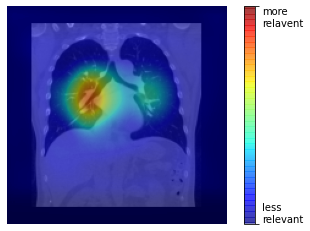

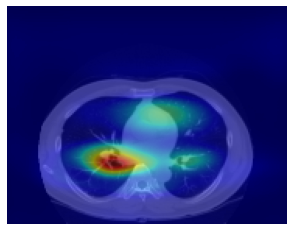

/workspace/lung_pft/external_validation/05_CAM_with_v3_01_averaged/on_sex_pool_1852210331
max coronal idx 75
maximum sagittal index:  52
axial max index:  75
(75, 52, 75)
0.25 0.312255859375


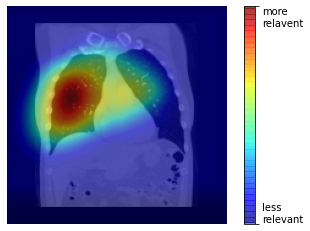

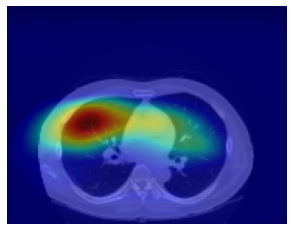

In [91]:
PATH_average = "/workspace/lung_pft/external_validation/05_CAM_with_v3_01_averaged"


_group = "pool"
_ID = dict_groupID[_group]
print(_group, _ID)
PATH_CT = os.path.join(PATH_average, f"03_crop_padded_v3_skimage_210511_{_ID}.hdr")
img_CT = load_image(PATH_CT)
img_CT = np.squeeze(img_CT)    

dict_FEV1_coronal_idx = {"pool": 96,
                        "F": 100, 
                        "M": 95}

dict_idx = {"coronal":[], 
            "sagittal":[],
            "axial":[]}
for _PFT in ["FEV1", "FVC"]:
    PATH_CAM_dir = os.path.join(PATH_average, f"on_sex_{_group}_{_ID}")
    print(PATH_CAM_dir)
    PATH_CAM = os.path.join(PATH_CAM_dir, _PFT, glob.glob(os.path.join(PATH_CAM_dir, _PFT, f'average_CAM_initial200skipped*_min_maxed_{_PFT}.hdr'))[0])
    _img_CAM =  sitk.GetArrayFromImage(sitk.ReadImage(PATH_CAM))
    _img_CAM = load_image(PATH_CAM)
    _img_CAM = np.squeeze(_img_CAM) 

    savename = f"{_group}_{_ID}_CAM_{_PFT}"
    max_coronal_idx, max_sagittal_idx, max_axial_idx = get_max_idx(_img_CAM, img_CT, PATH_CAM_dir, savename)

    if _PFT =="FEV1":
        max_coronal_idx = dict_FEV1_coronal_idx[_group]

    list_max_idx = max_coronal_idx, max_sagittal_idx, max_axial_idx   
    print(list_max_idx)
    savename = f"{_group}_{_ID}_CAM_CHOSEN_{_PFT}"
    plot_max_CAM(_img_CAM, img_CT,list_max_idx , PATH_CAM_dir, savename,
                 with_line = False, 
                  save = True)    

    dict_idx["coronal"].append(max_coronal_idx)
    dict_idx["sagittal"].append(max_sagittal_idx)
    dict_idx["axial"].append(max_axial_idx)


## Figure S7 - GradCAM  sample 

M    8
F    2
Name: sex, dtype: int64


1852023081


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
861,1852023081,M,56,164.3,82.3,30.488,107.0,2.32,70,3.0,67,77


M


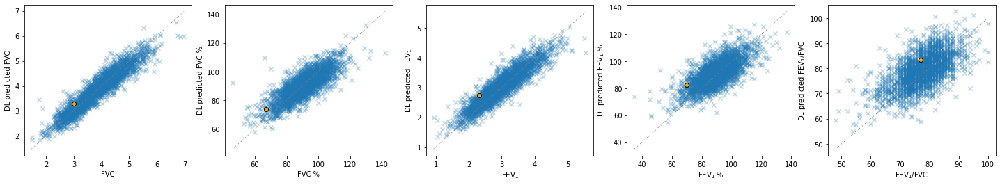

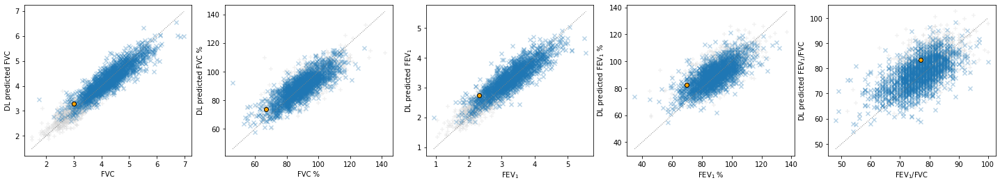

max coronal idx 96
maximum sagittal index:  71
axial max index:  88
coronal idx 84


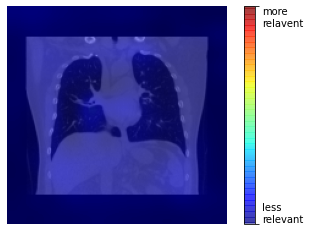

coronal idx 85


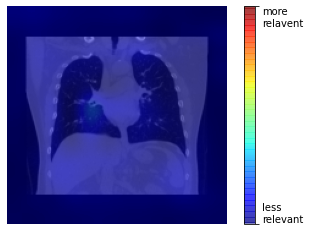

coronal idx 86


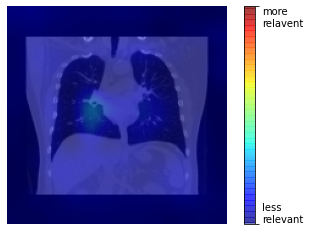

coronal idx 87


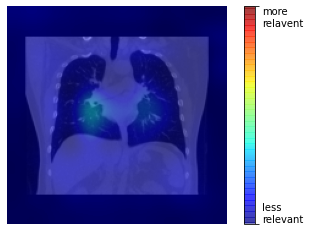

coronal idx 88


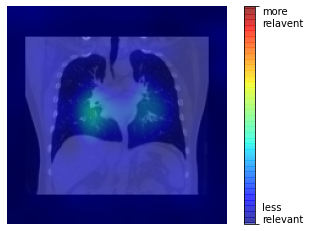

coronal idx 89


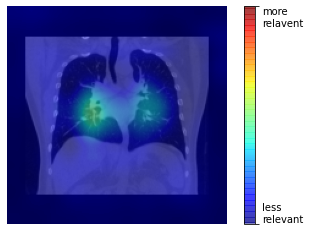

coronal idx 90


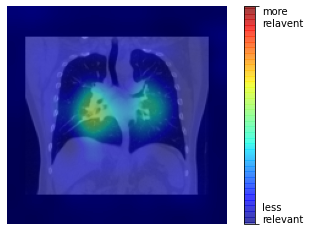

coronal idx 91


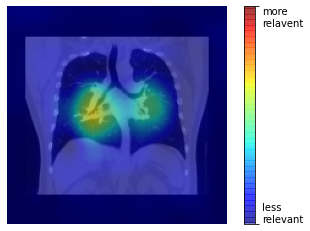

coronal idx 92


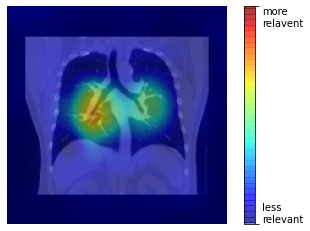

coronal idx 93


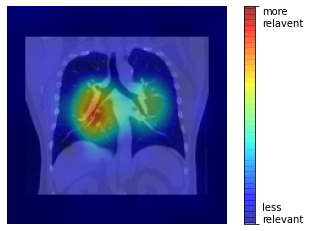

coronal idx 94


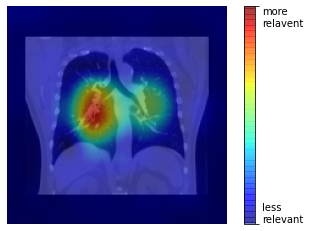

coronal idx 95


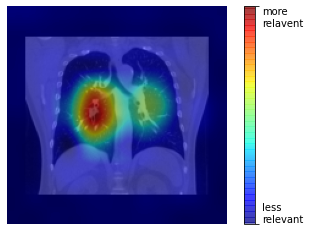

coronal idx 96


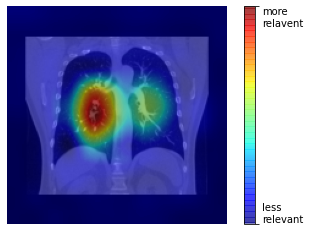

coronal idx 97


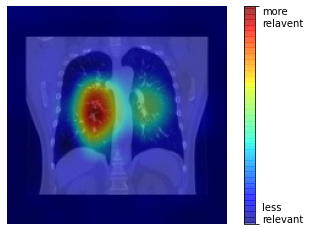

(96, 71, 88)
0.25 0.312255859375


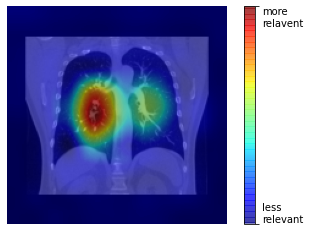

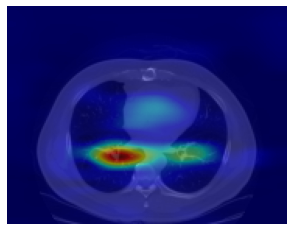

max coronal idx 69
maximum sagittal index:  55
axial max index:  84
coronal idx 57


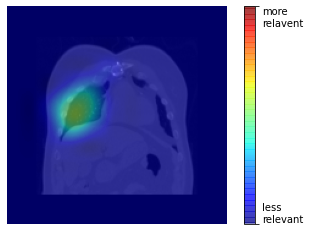

coronal idx 58


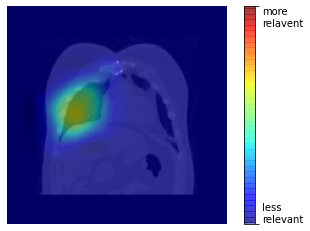

coronal idx 59


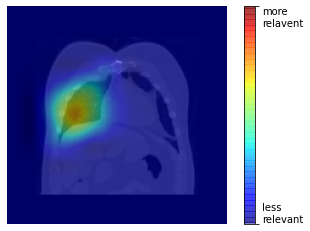

coronal idx 60


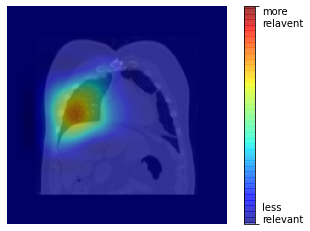

coronal idx 61


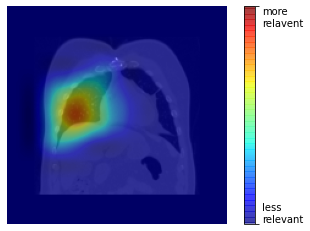

coronal idx 62


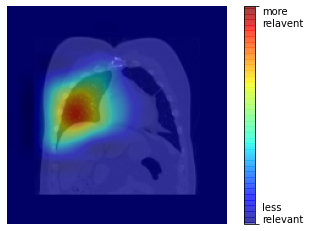

coronal idx 63


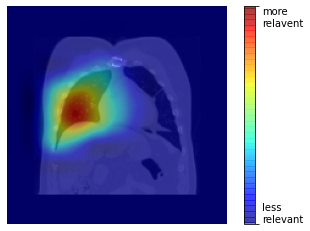

coronal idx 64


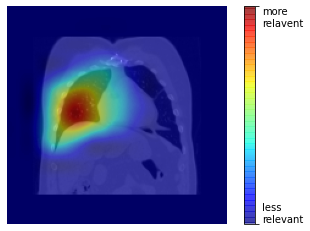

coronal idx 65


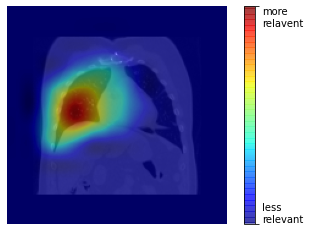

coronal idx 66


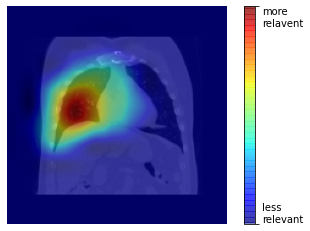

coronal idx 67


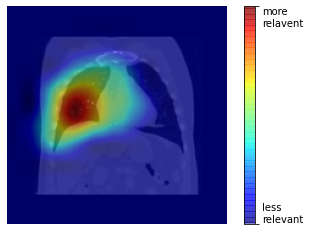

coronal idx 68


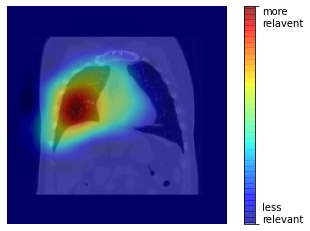

coronal idx 69


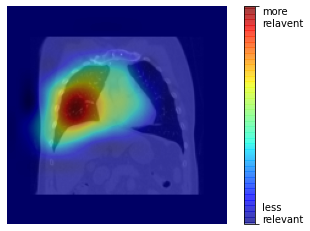

coronal idx 70


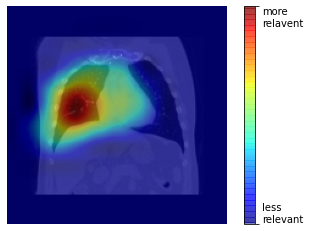

(69, 55, 84)
0.25 0.312255859375


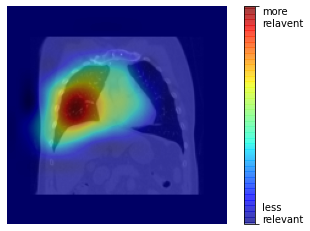

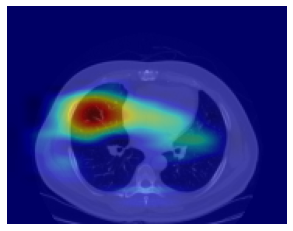



1852094808


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
544,1852094808,F,70,146.4,63.5,29.627,97.0,1.77,96,2.09,81,84


F


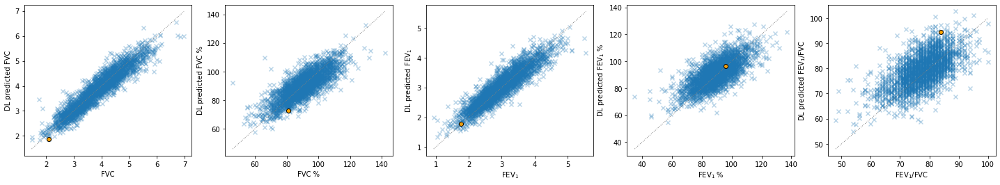

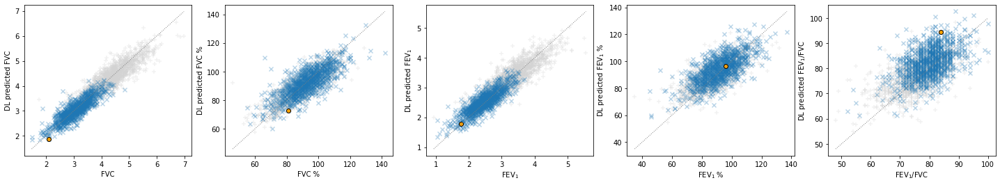

max coronal idx 97
maximum sagittal index:  74
axial max index:  80
coronal idx 85


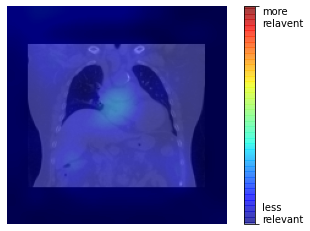

coronal idx 86


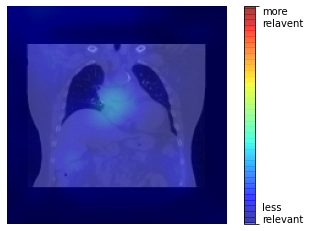

coronal idx 87


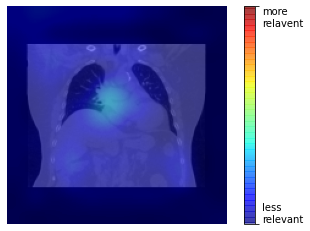

coronal idx 88


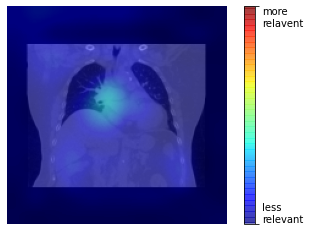

coronal idx 89


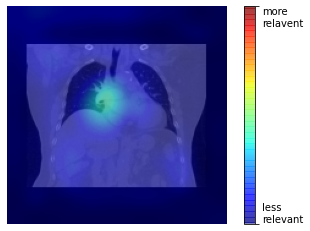

coronal idx 90


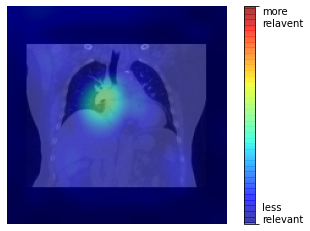

coronal idx 91


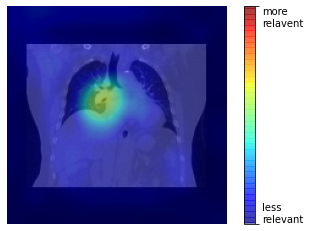

coronal idx 92


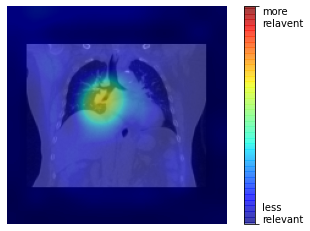

coronal idx 93


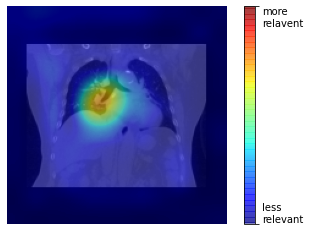

coronal idx 94


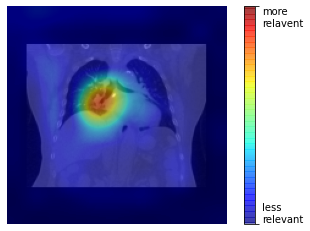

coronal idx 95


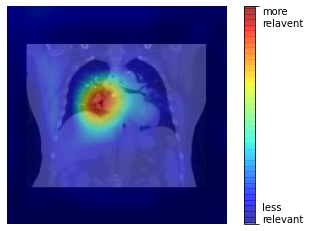

coronal idx 96


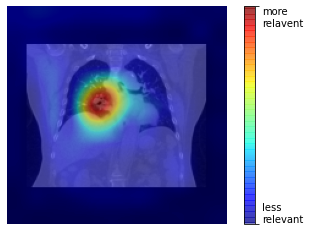

coronal idx 97


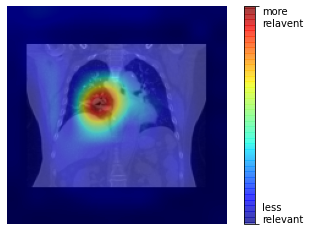

coronal idx 98


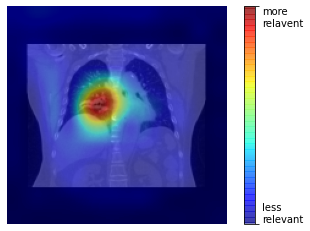

(97, 74, 80)
0.25 0.312255859375


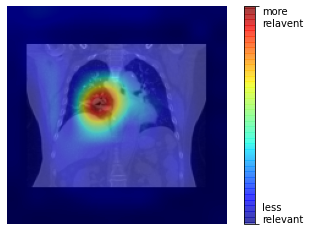

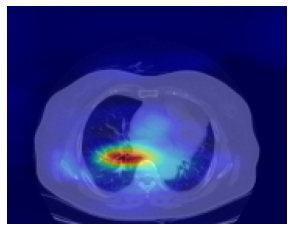

max coronal idx 74
maximum sagittal index:  60
axial max index:  86
coronal idx 62


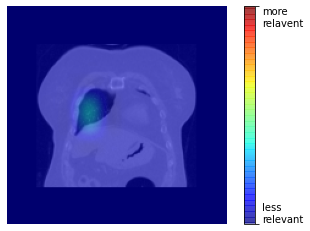

coronal idx 63


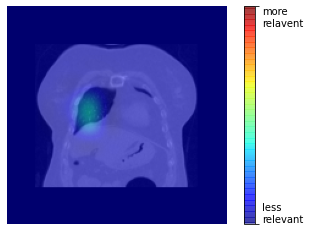

coronal idx 64


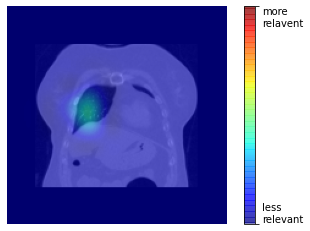

coronal idx 65


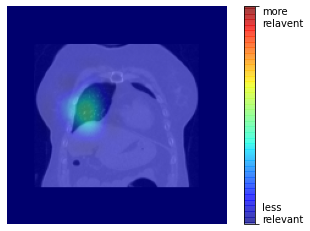

coronal idx 66


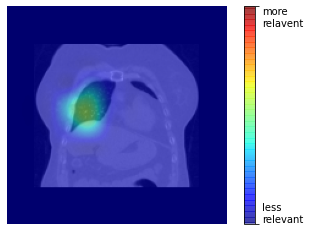

coronal idx 67


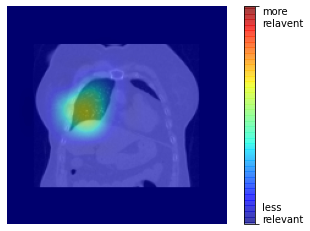

coronal idx 68


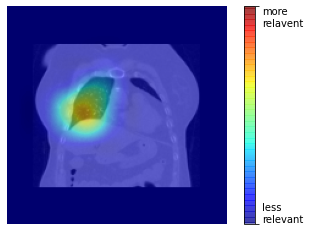

coronal idx 69


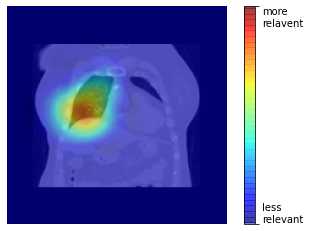

coronal idx 70


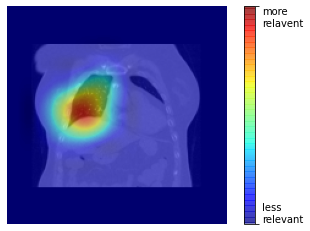

coronal idx 71


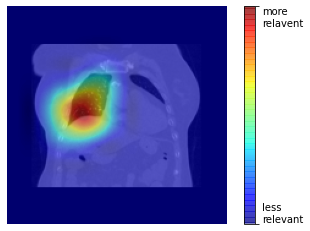

coronal idx 72


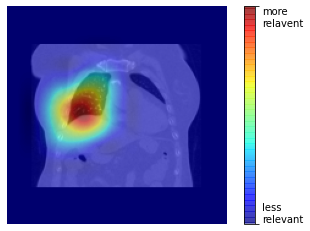

coronal idx 73


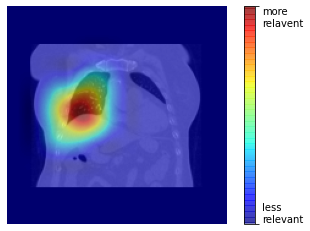

coronal idx 74


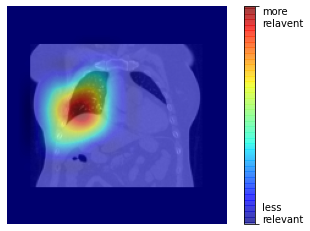

coronal idx 75


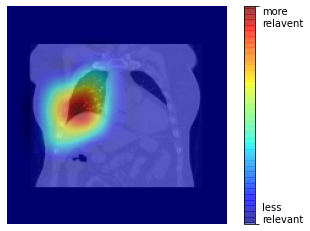

(74, 60, 86)
0.25 0.312255859375


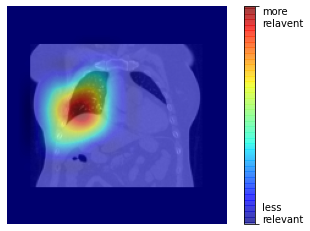

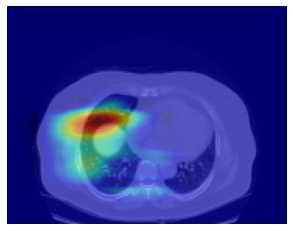



1852331347


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
2370,1852331347,M,59,164.7,64.7,23.852,87.0,2.88,88,3.87,90,74


M


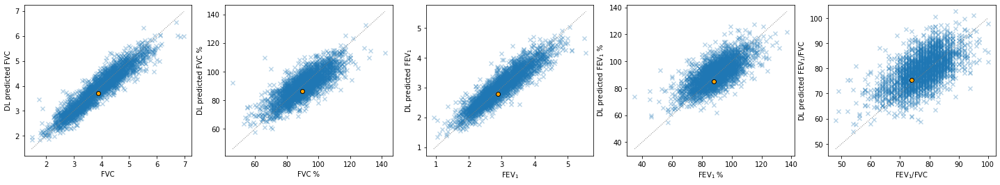

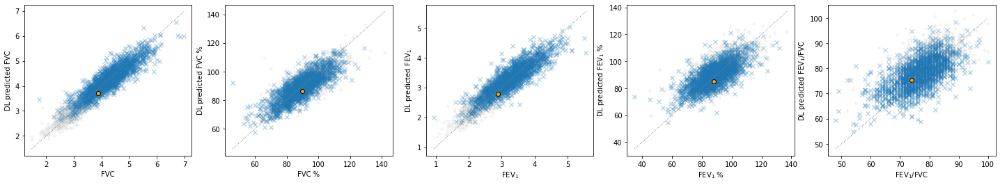

max coronal idx 98
maximum sagittal index:  71
axial max index:  89
coronal idx 86


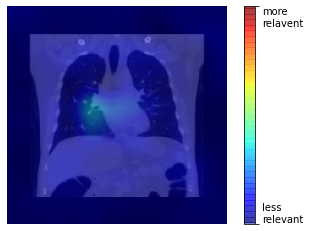

coronal idx 87


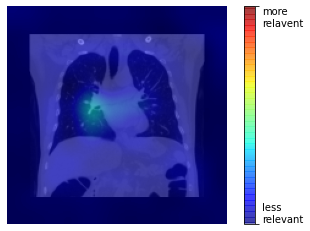

coronal idx 88


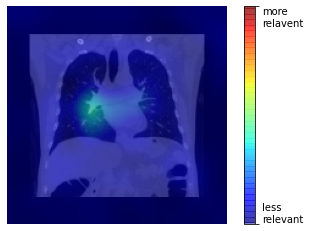

coronal idx 89


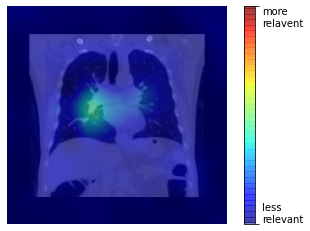

coronal idx 90


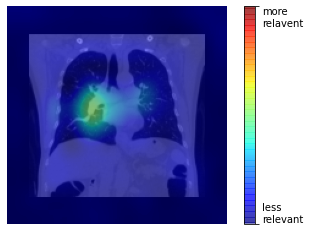

coronal idx 91


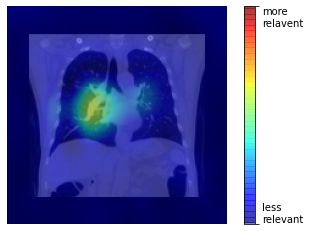

coronal idx 92


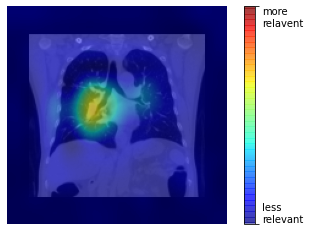

coronal idx 93


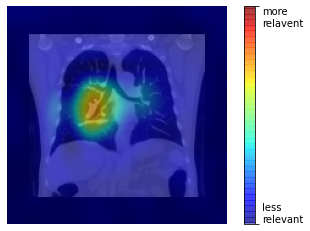

coronal idx 94


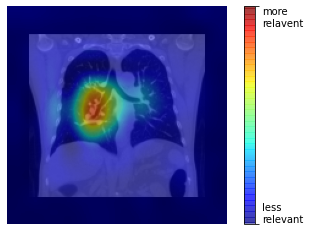

coronal idx 95


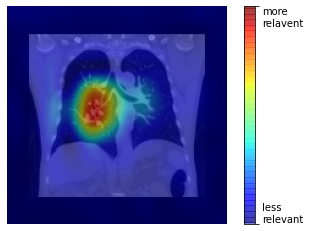

coronal idx 96


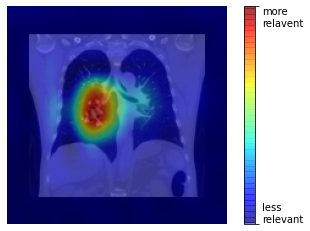

coronal idx 97


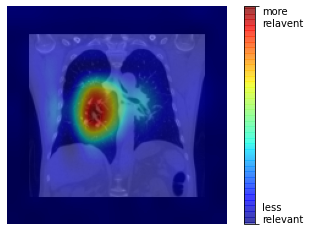

coronal idx 98


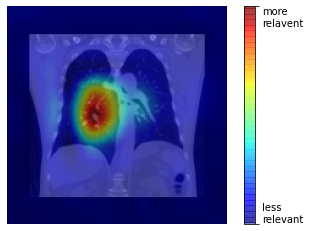

coronal idx 99


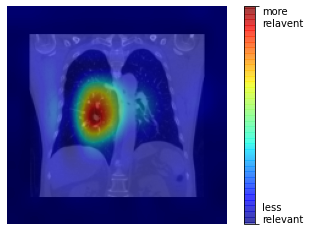

(98, 71, 89)
0.25 0.312255859375


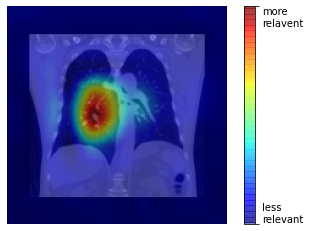

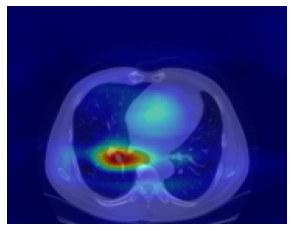

max coronal idx 68
maximum sagittal index:  55
axial max index:  86
coronal idx 56


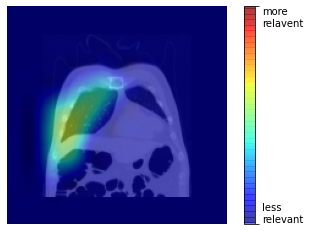

coronal idx 57


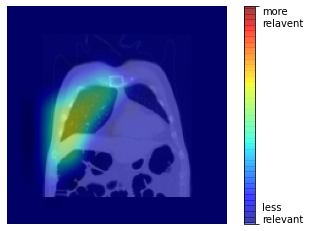

coronal idx 58


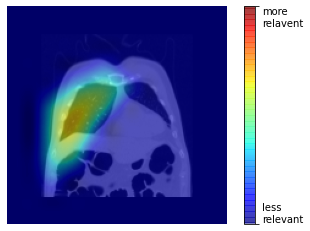

coronal idx 59


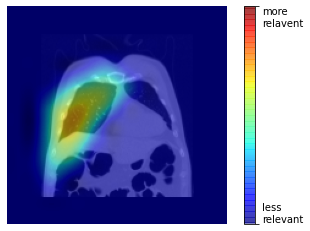

coronal idx 60


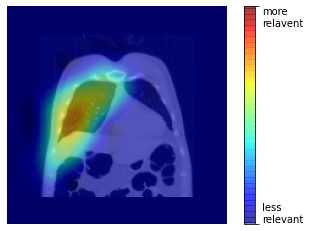

coronal idx 61


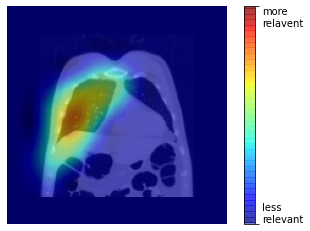

coronal idx 62


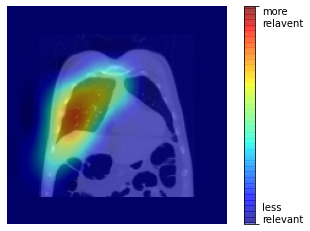

coronal idx 63


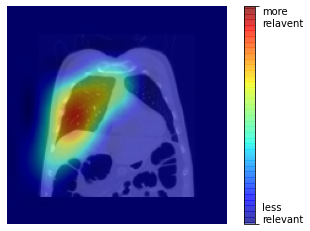

coronal idx 64


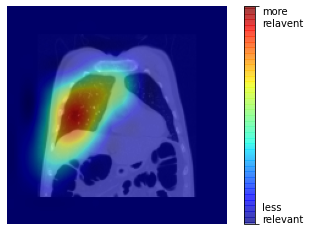

coronal idx 65


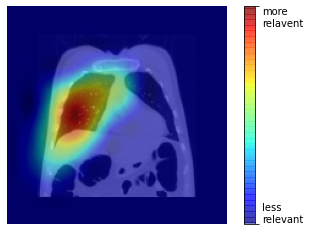

coronal idx 66


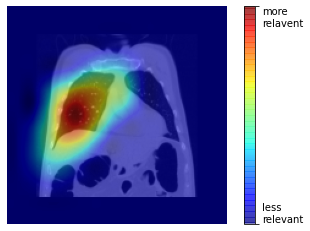

coronal idx 67


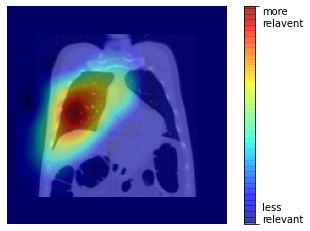

coronal idx 68


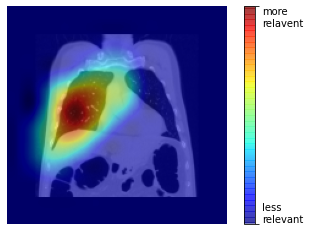

coronal idx 69


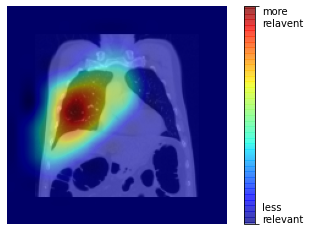

(68, 55, 86)
0.25 0.312255859375


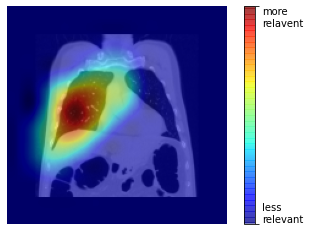

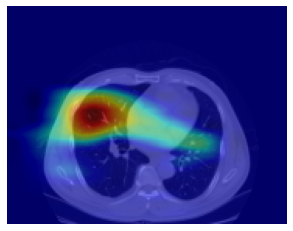



1852276415


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
1094,1852276415,F,53,163.6,48.2,18.009,68.5,2.61,90,3.37,98,77


F


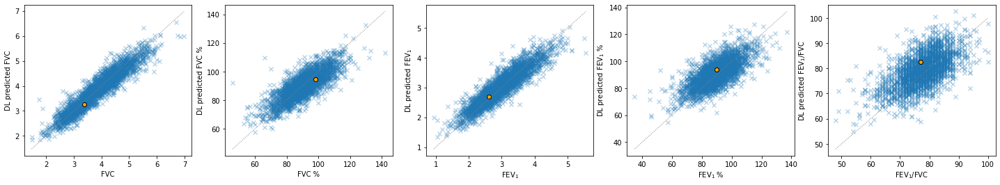

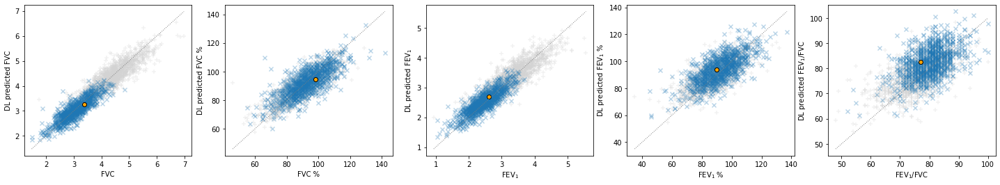

max coronal idx 104
maximum sagittal index:  70
axial max index:  89
coronal idx 92


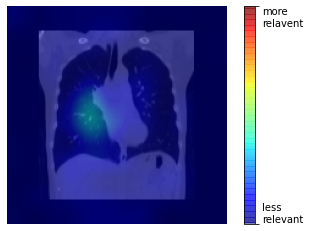

coronal idx 93


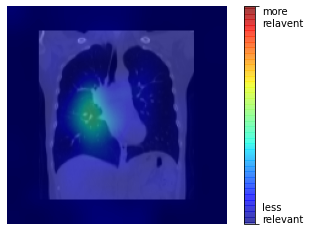

coronal idx 94


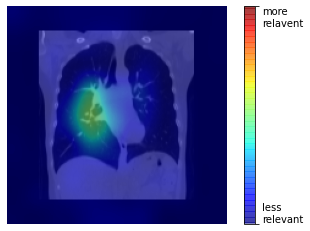

coronal idx 95


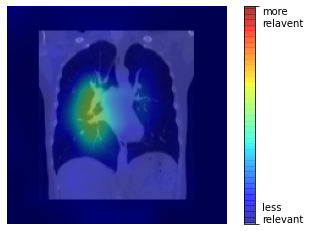

coronal idx 96


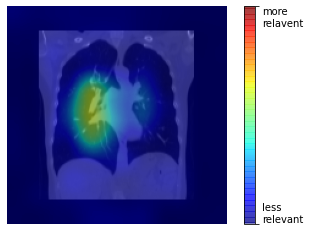

coronal idx 97


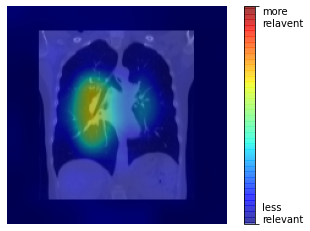

coronal idx 98


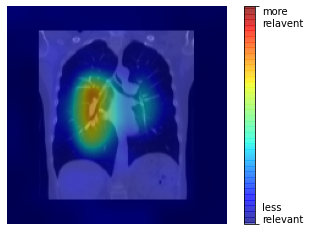

coronal idx 99


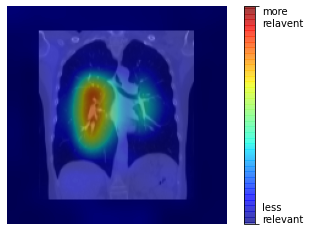

coronal idx 100


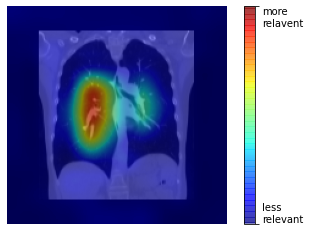

coronal idx 101


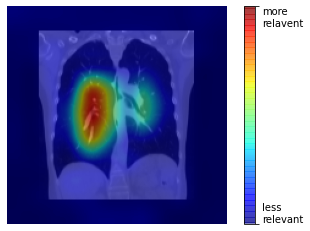

coronal idx 102


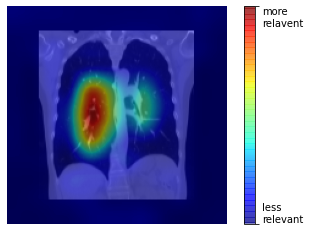

coronal idx 103


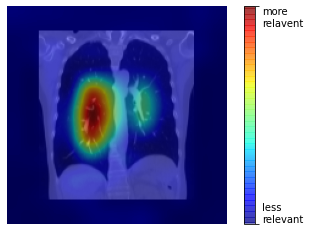

coronal idx 104


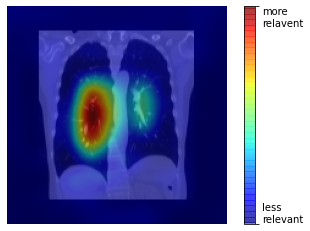

coronal idx 105


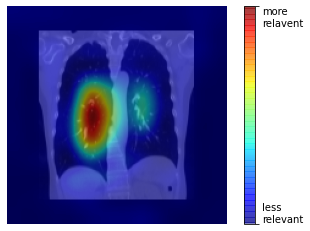

(104, 70, 89)
0.25 0.312255859375


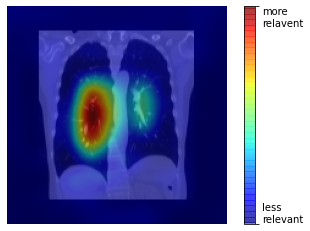

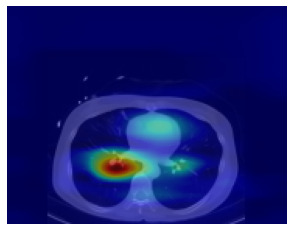

max coronal idx 83
maximum sagittal index:  54
axial max index:  84
coronal idx 71


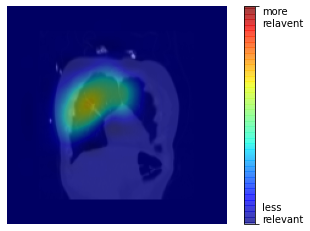

coronal idx 72


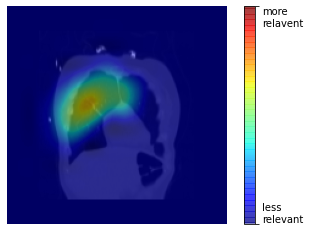

coronal idx 73


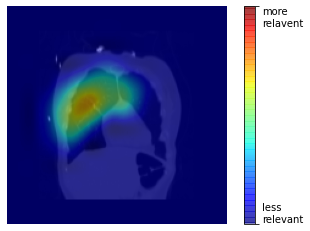

coronal idx 74


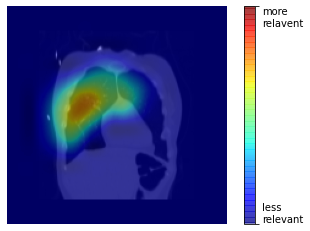

coronal idx 75


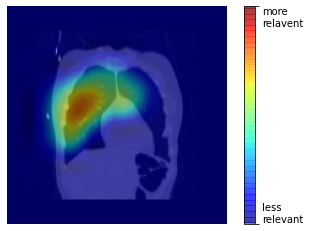

coronal idx 76


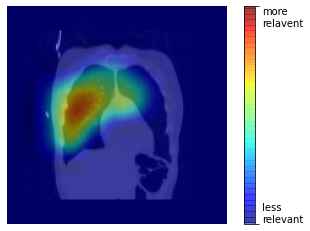

coronal idx 77


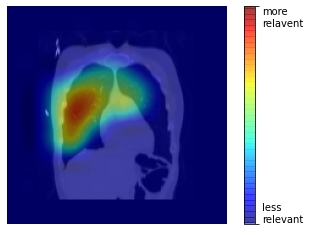

coronal idx 78


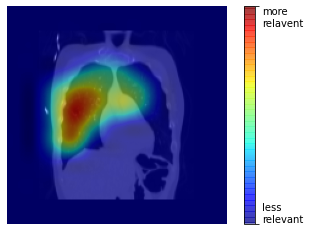

coronal idx 79


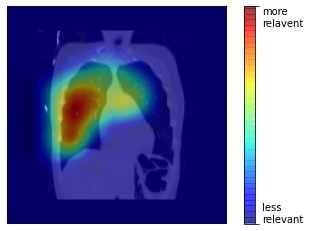

coronal idx 80


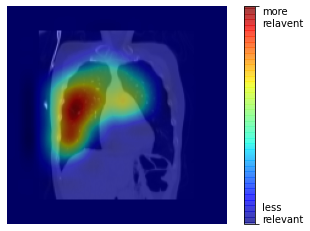

coronal idx 81


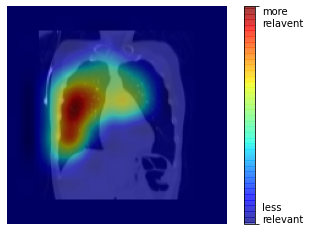

coronal idx 82


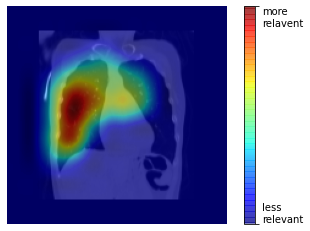

coronal idx 83


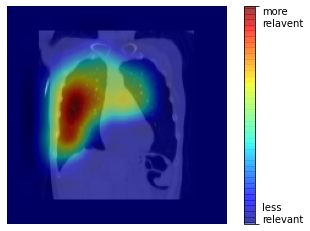

coronal idx 84


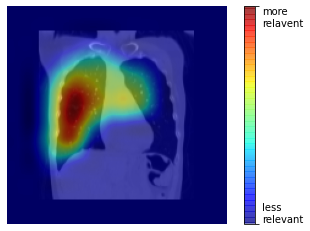

(83, 54, 84)
0.25 0.312255859375


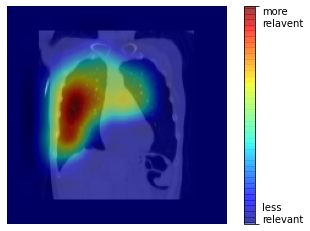

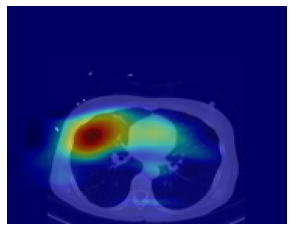



1852252732


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
2709,1852252732,M,46,178.9,65.0,20.309,79.0,3.79,89,4.86,94,78


M


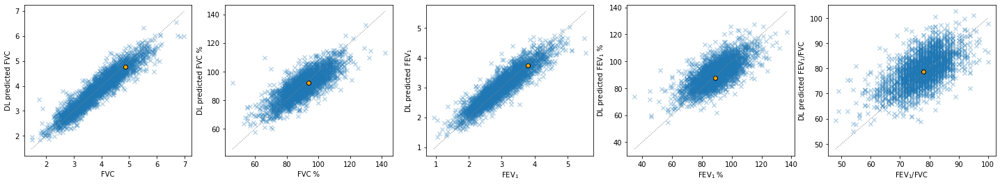

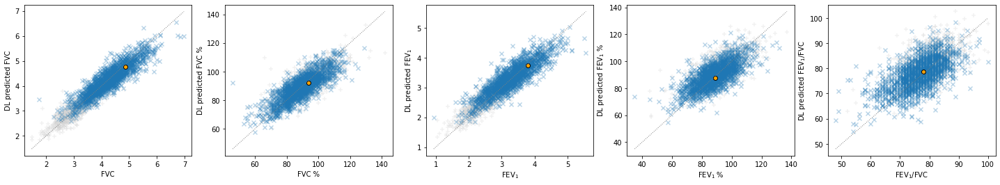

max coronal idx 103
maximum sagittal index:  68
axial max index:  91
coronal idx 91


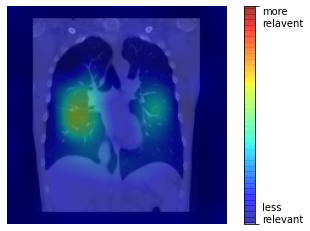

coronal idx 92


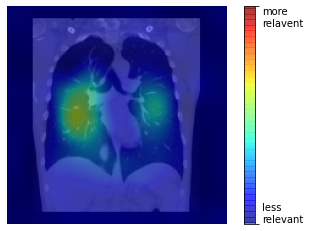

coronal idx 93


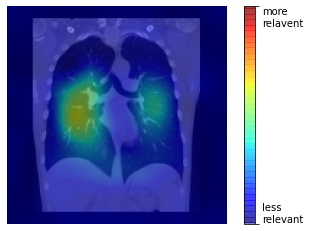

coronal idx 94


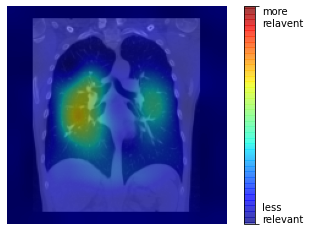

coronal idx 95


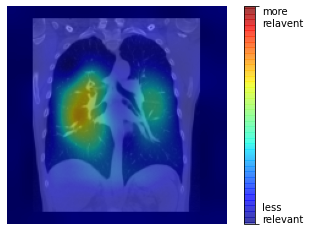

coronal idx 96


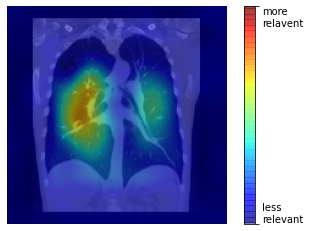

coronal idx 97


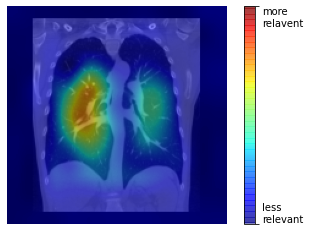

coronal idx 98


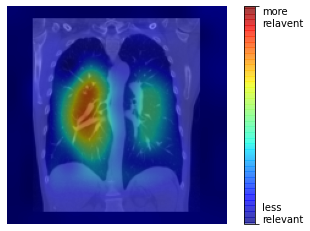

coronal idx 99


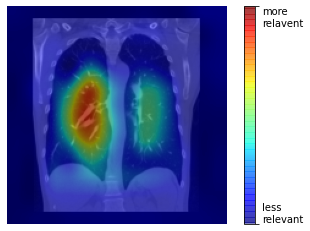

coronal idx 100


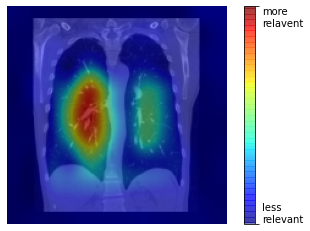

coronal idx 101


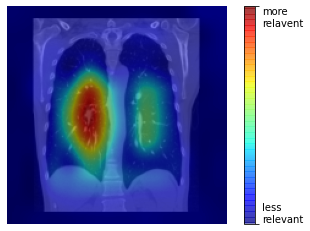

coronal idx 102


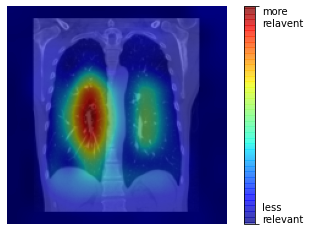

coronal idx 103


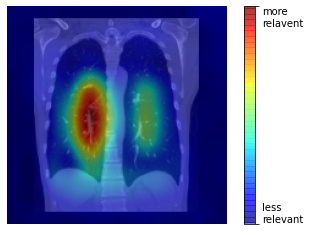

coronal idx 104


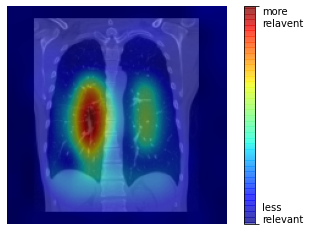

(103, 68, 91)
0.25 0.312255859375


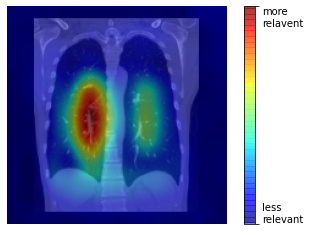

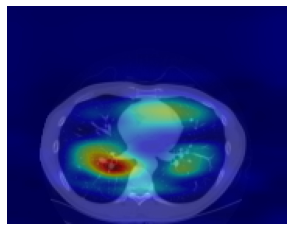

max coronal idx 72
maximum sagittal index:  53
axial max index:  83
coronal idx 60


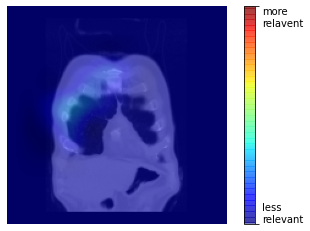

coronal idx 61


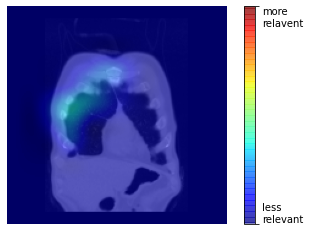

coronal idx 62


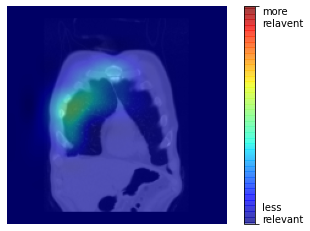

coronal idx 63


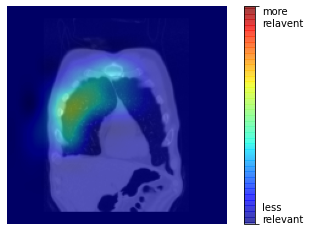

coronal idx 64


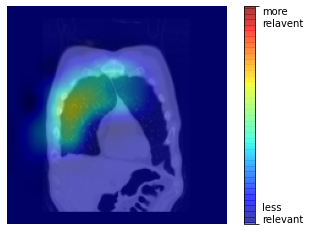

coronal idx 65


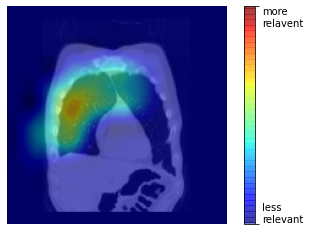

coronal idx 66


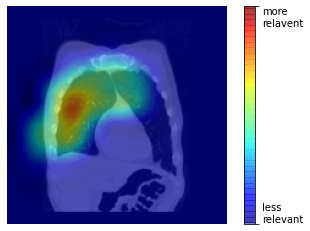

coronal idx 67


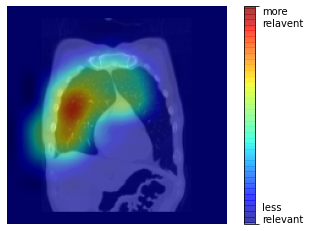

coronal idx 68


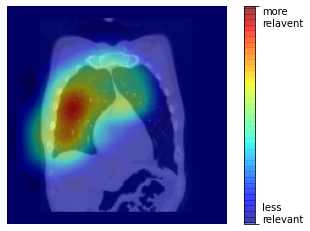

coronal idx 69


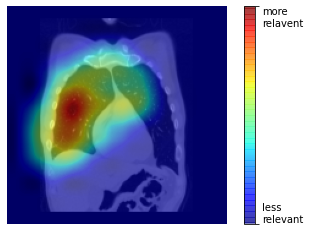

coronal idx 70


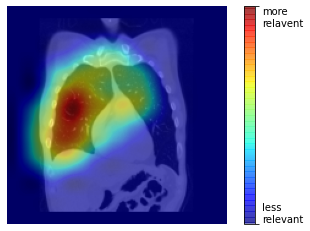

coronal idx 71


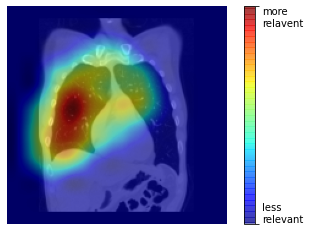

coronal idx 72


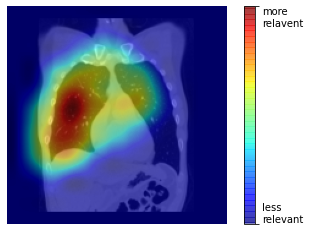

coronal idx 73


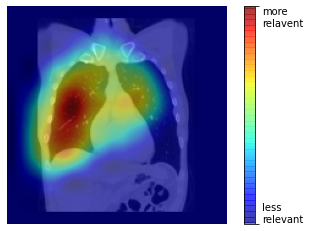

(72, 53, 83)
0.25 0.312255859375


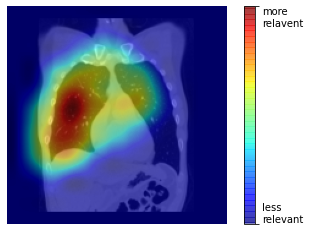

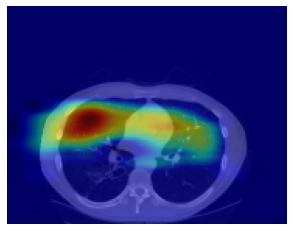



1852314546


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
921,1852314546,M,48,169.9,64.4,22.31,80.0,3.05,80,4.81,103,63


M


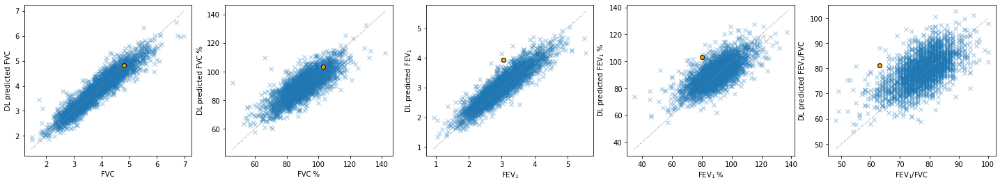

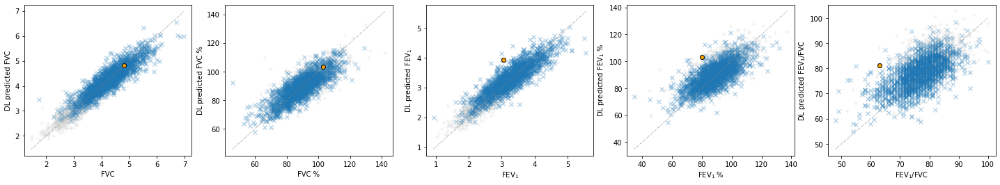

max coronal idx 95
maximum sagittal index:  68
axial max index:  93
coronal idx 83


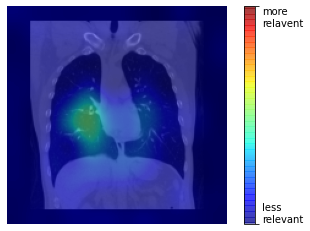

coronal idx 84


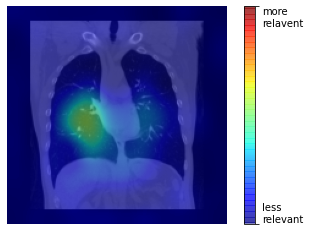

coronal idx 85


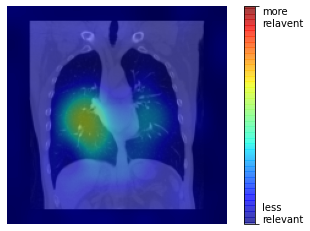

coronal idx 86


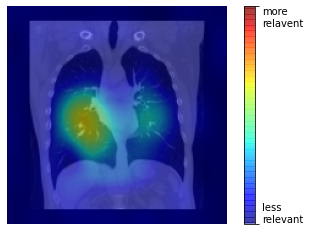

coronal idx 87


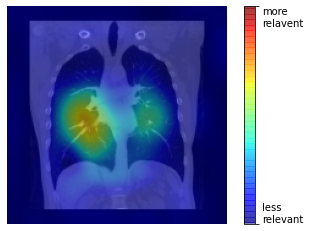

coronal idx 88


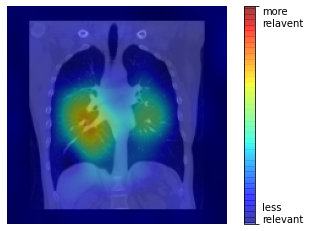

coronal idx 89


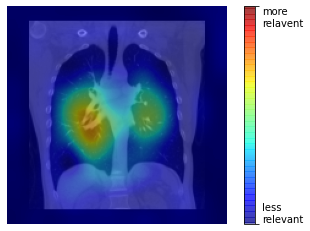

coronal idx 90


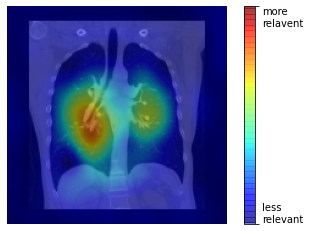

coronal idx 91


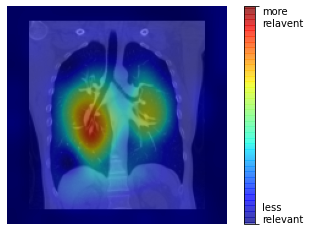

coronal idx 92


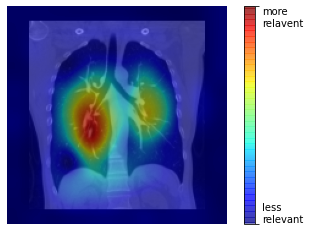

coronal idx 93


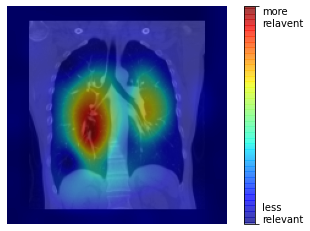

coronal idx 94


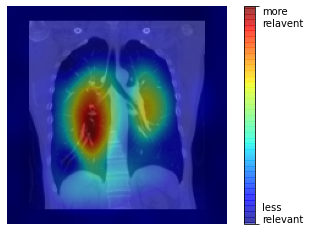

coronal idx 95


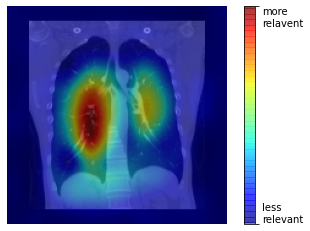

coronal idx 96


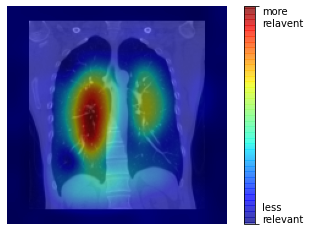

(95, 68, 93)
0.25 0.312255859375


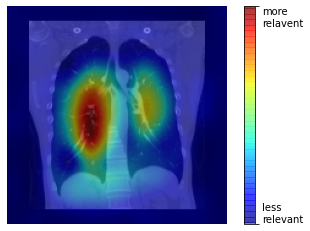

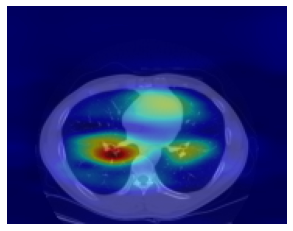

max coronal idx 71
maximum sagittal index:  55
axial max index:  83
coronal idx 59


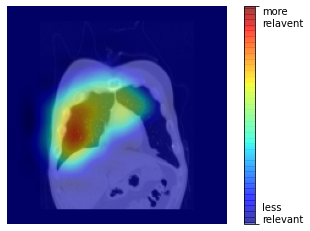

coronal idx 60


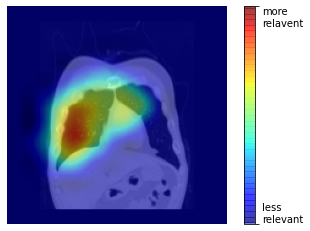

coronal idx 61


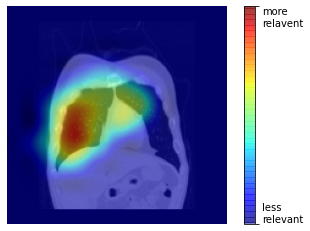

coronal idx 62


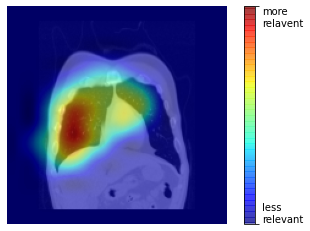

coronal idx 63


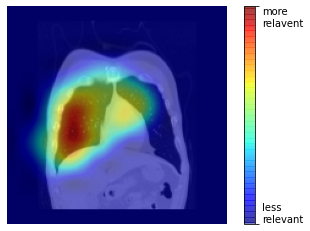

coronal idx 64


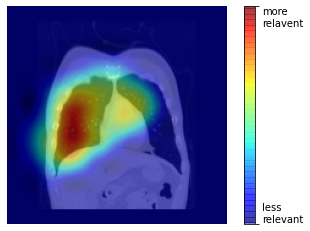

coronal idx 65


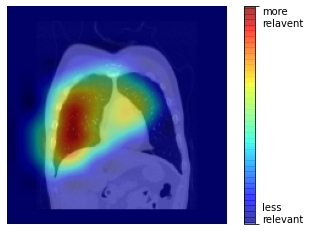

coronal idx 66


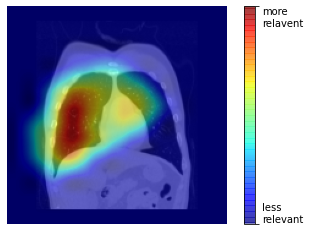

coronal idx 67


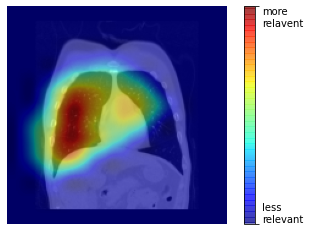

coronal idx 68


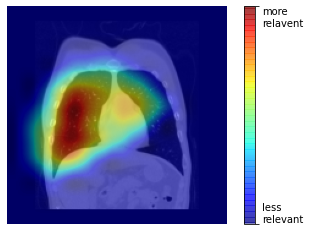

coronal idx 69


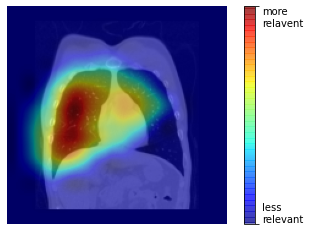

coronal idx 70


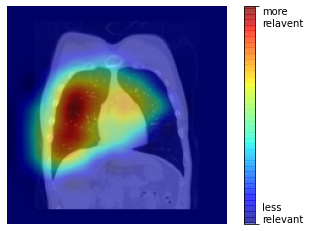

coronal idx 71


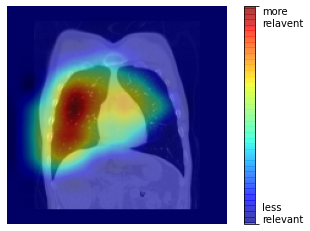

coronal idx 72


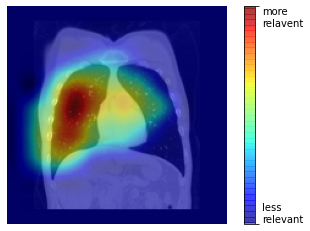

(71, 55, 83)
0.25 0.312255859375


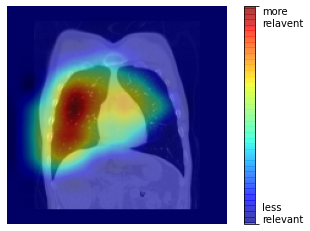

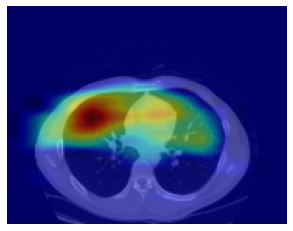



1852124522


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
2320,1852124522,M,39,167.7,78.6,27.948,98.0,3.01,77,3.52,74,86


M


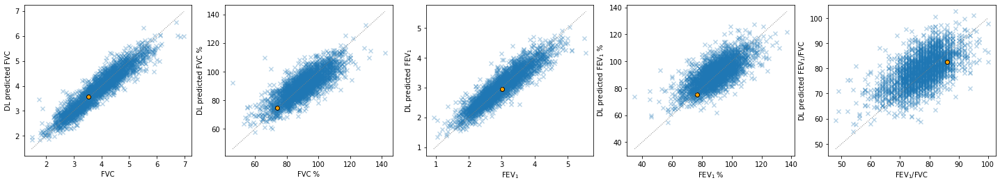

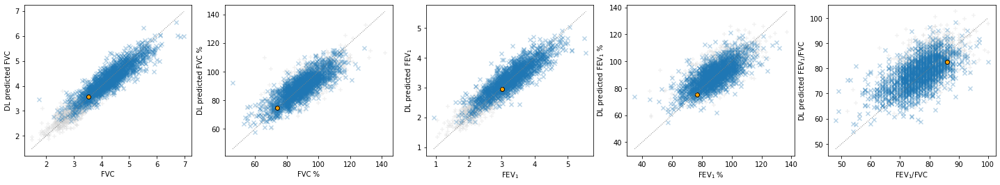

max coronal idx 96
maximum sagittal index:  70
axial max index:  81
coronal idx 84


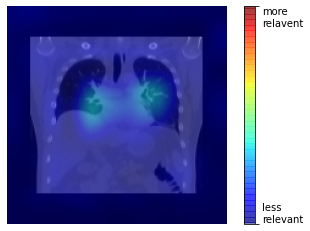

coronal idx 85


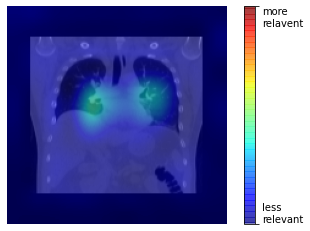

coronal idx 86


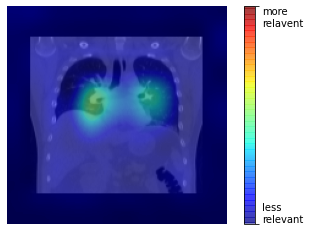

coronal idx 87


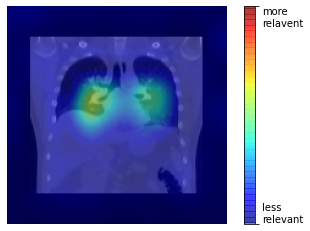

coronal idx 88


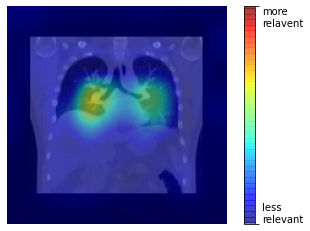

coronal idx 89


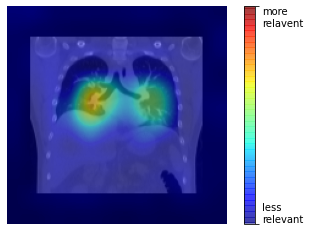

coronal idx 90


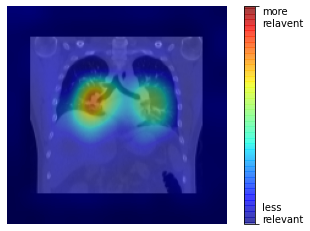

coronal idx 91


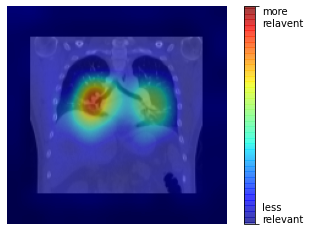

coronal idx 92


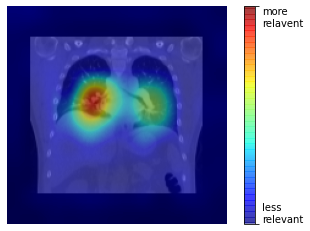

coronal idx 93


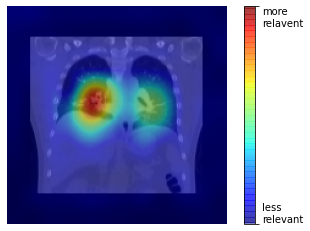

coronal idx 94


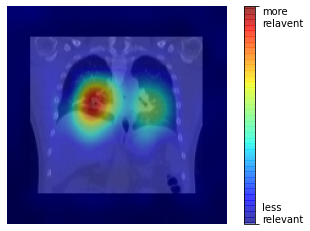

coronal idx 95


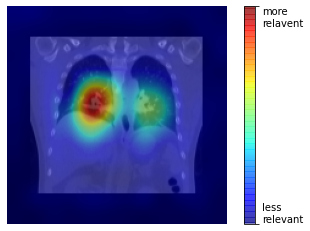

coronal idx 96


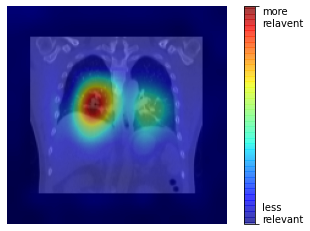

coronal idx 97


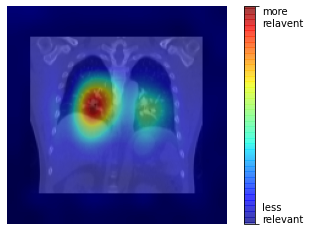

(96, 70, 81)
0.25 0.312255859375


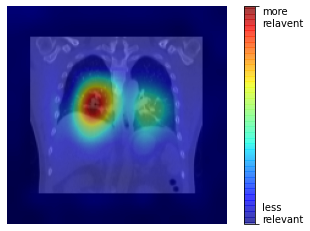

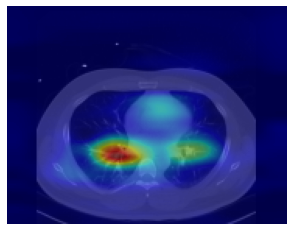

max coronal idx 71
maximum sagittal index:  54
axial max index:  86
coronal idx 59


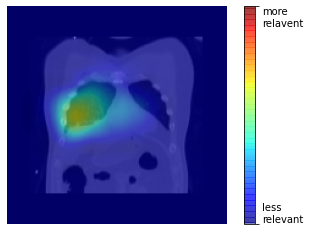

coronal idx 60


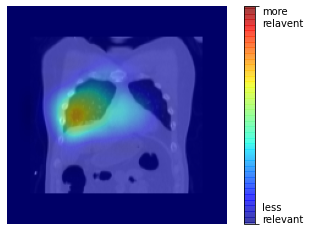

coronal idx 61


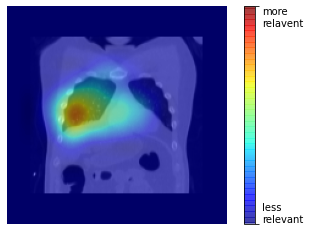

coronal idx 62


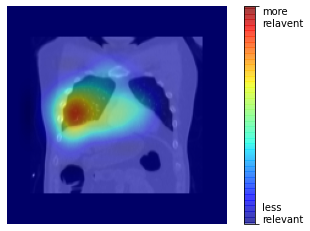

coronal idx 63


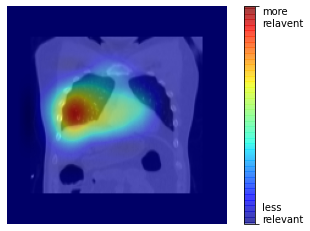

coronal idx 64


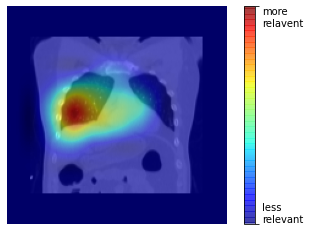

coronal idx 65


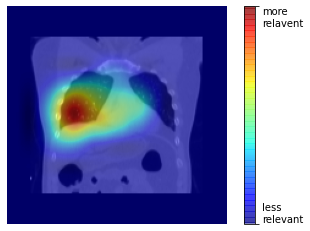

coronal idx 66


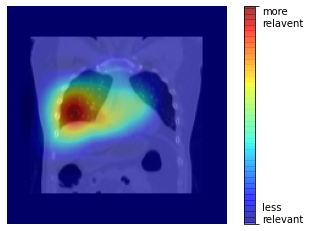

coronal idx 67


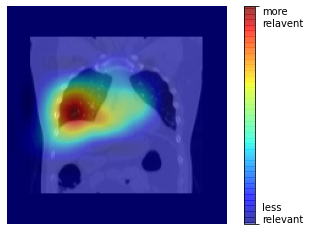

coronal idx 68


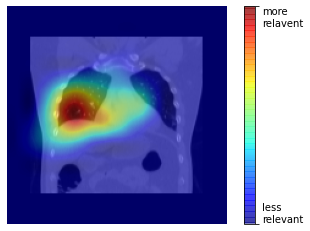

coronal idx 69


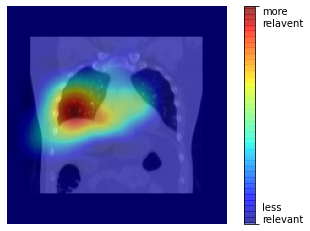

coronal idx 70


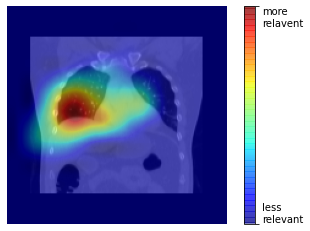

coronal idx 71


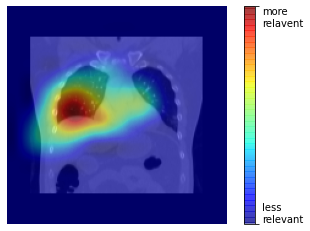

coronal idx 72


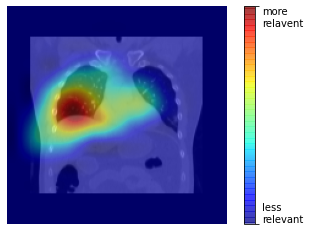

(71, 54, 86)
0.25 0.312255859375


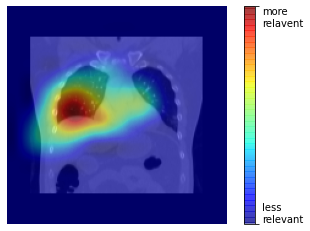

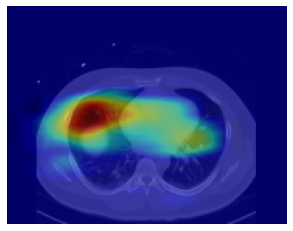



1852189486


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
2016,1852189486,M,54,169.8,78.1,27.088,92.0,3.0,82,3.94,83,76


M


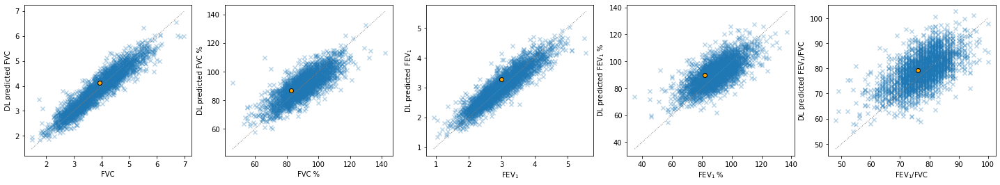

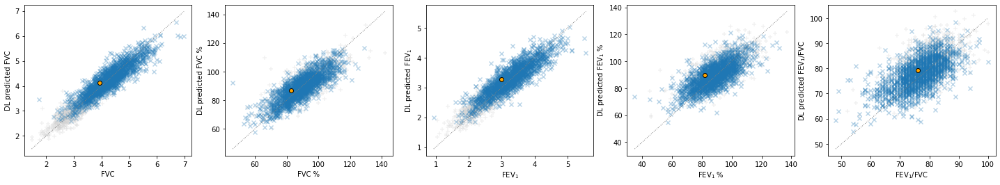

max coronal idx 100
maximum sagittal index:  70
axial max index:  90
coronal idx 88


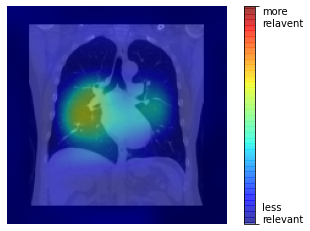

coronal idx 89


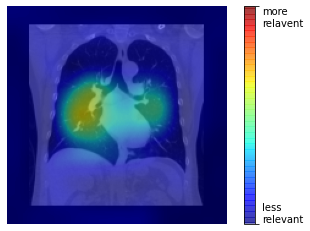

coronal idx 90


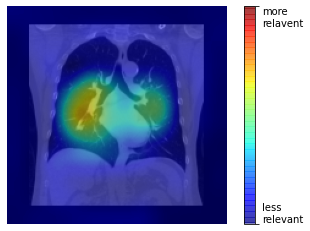

coronal idx 91


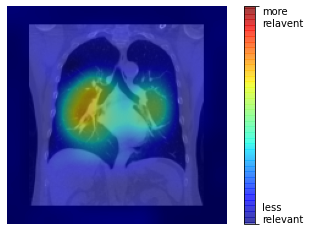

coronal idx 92


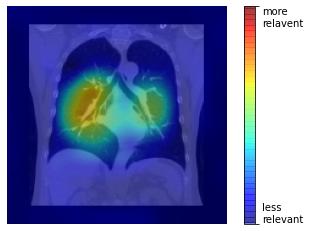

coronal idx 93


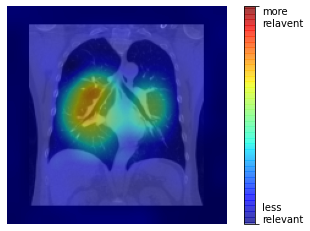

coronal idx 94


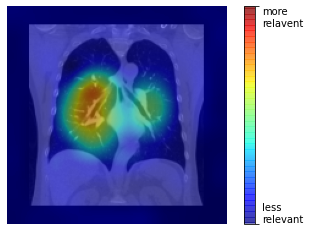

coronal idx 95


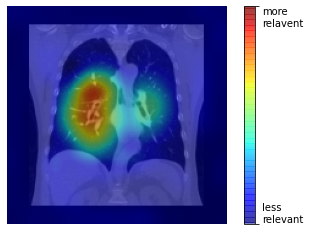

coronal idx 96


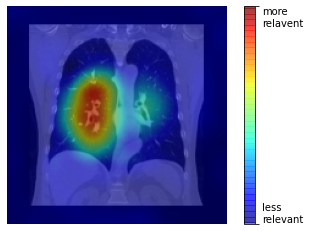

coronal idx 97


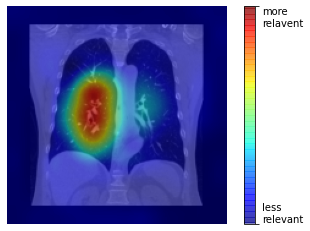

coronal idx 98


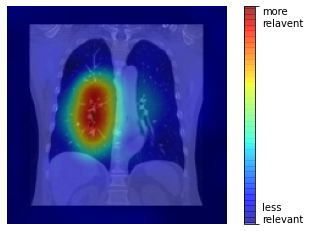

coronal idx 99


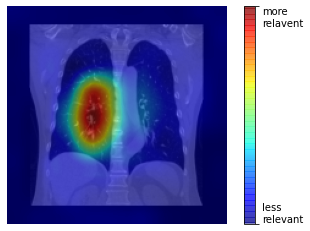

coronal idx 100


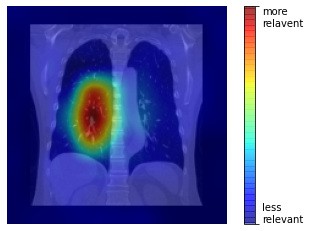

coronal idx 101


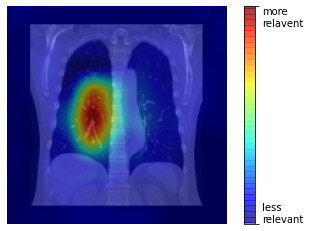

(100, 70, 90)
0.25 0.312255859375


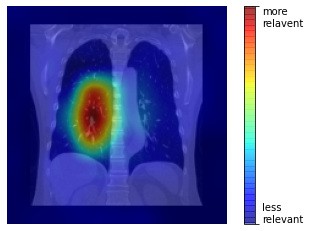

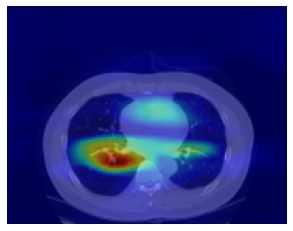

max coronal idx 72
maximum sagittal index:  55
axial max index:  84
coronal idx 60


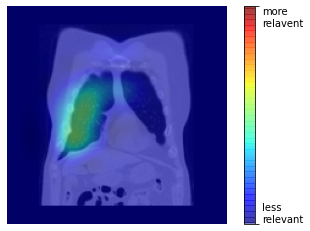

coronal idx 61


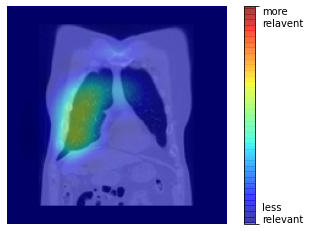

coronal idx 62


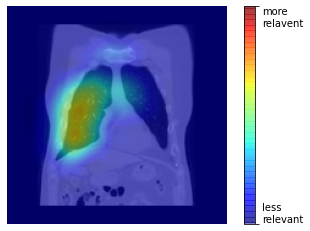

coronal idx 63


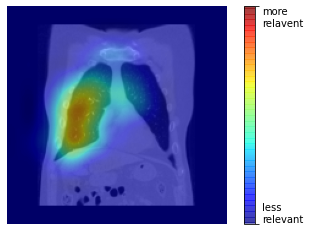

coronal idx 64


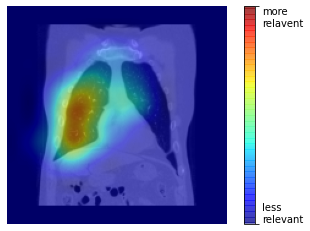

coronal idx 65


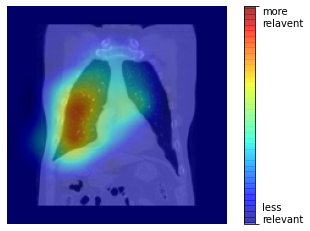

coronal idx 66


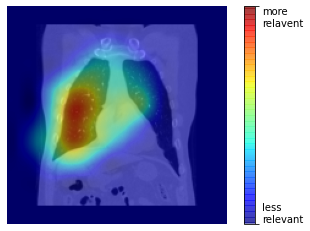

coronal idx 67


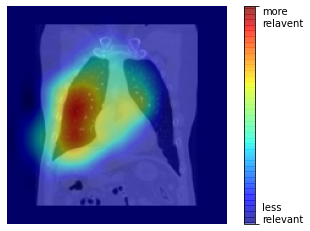

coronal idx 68


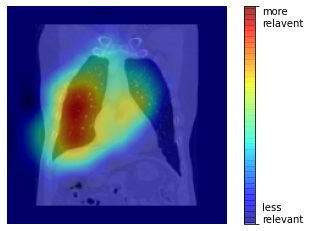

coronal idx 69


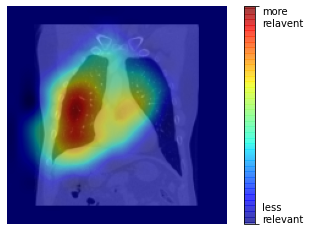

coronal idx 70


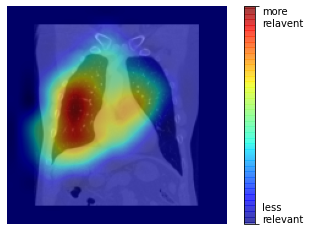

coronal idx 71


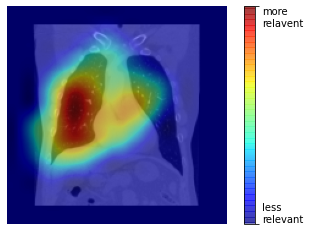

coronal idx 72


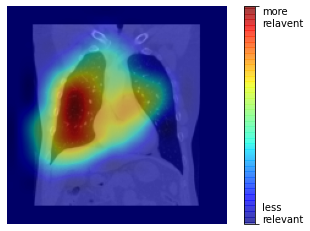

coronal idx 73


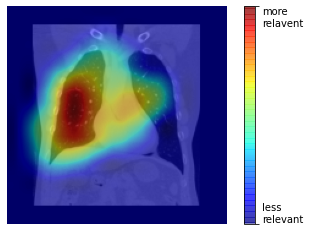

(72, 55, 84)
0.25 0.312255859375


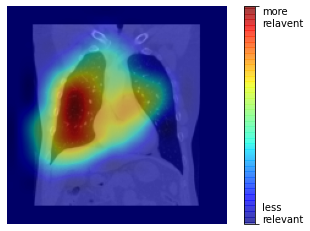

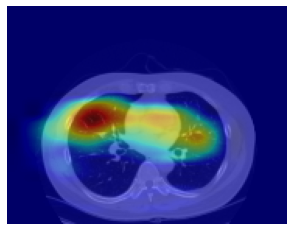



1852011071


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
2222,1852011071,M,62,172.9,67.5,22.579,88.0,3.21,90,4.03,85,80


M


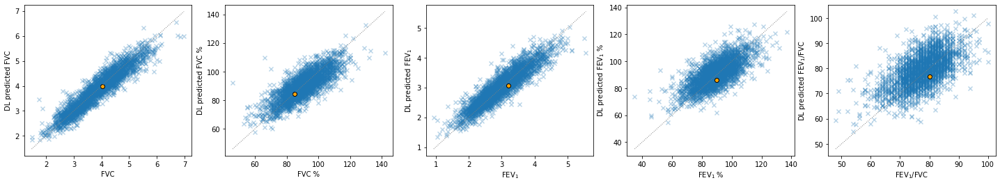

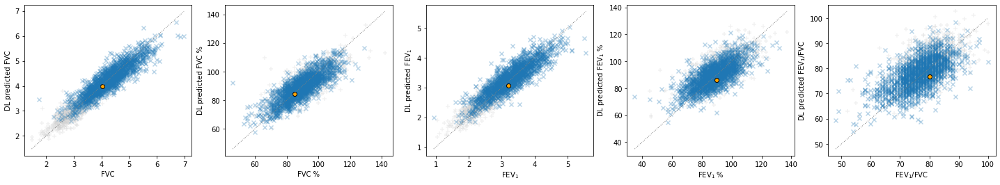

max coronal idx 102
maximum sagittal index:  71
axial max index:  90
coronal idx 90


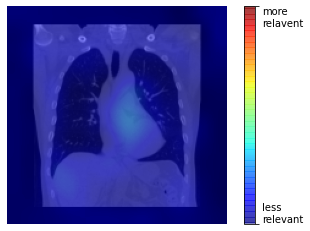

coronal idx 91


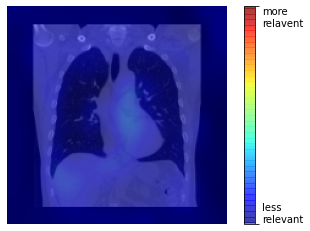

coronal idx 92


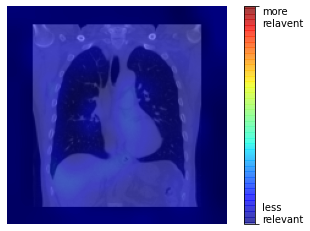

coronal idx 93


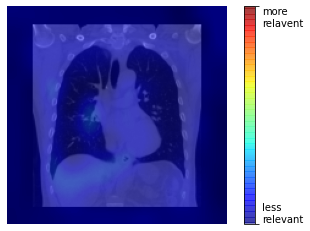

coronal idx 94


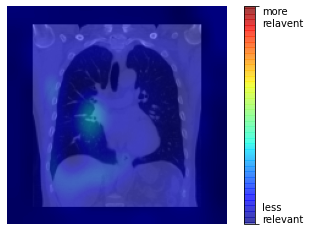

coronal idx 95


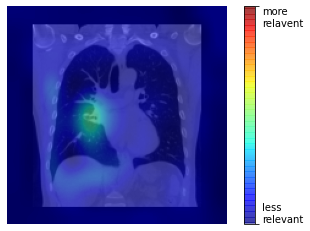

coronal idx 96


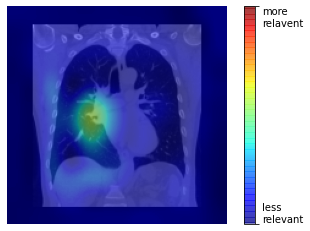

coronal idx 97


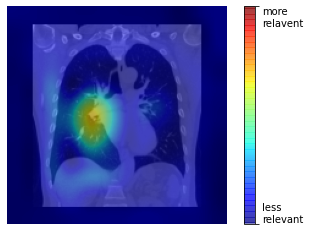

coronal idx 98


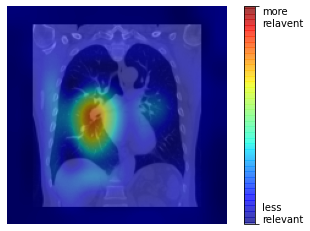

coronal idx 99


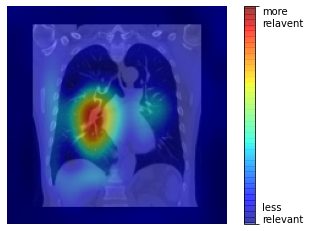

coronal idx 100


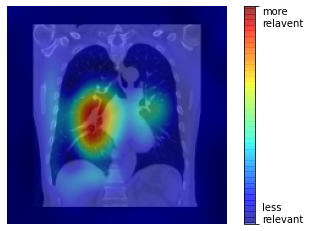

coronal idx 101


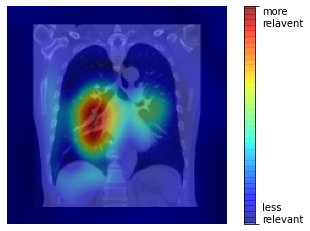

coronal idx 102


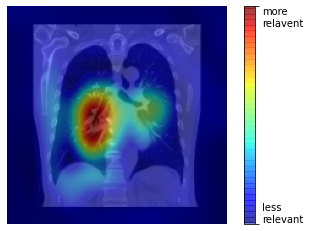

coronal idx 103


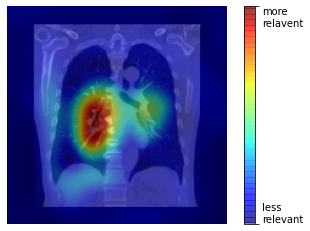

(102, 71, 90)
0.25 0.312255859375


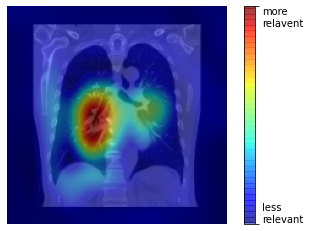

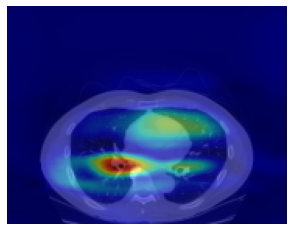

max coronal idx 79
maximum sagittal index:  54
axial max index:  89
coronal idx 67


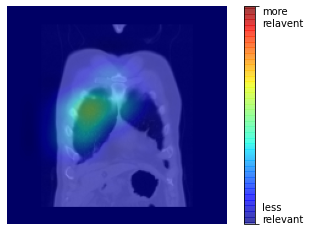

coronal idx 68


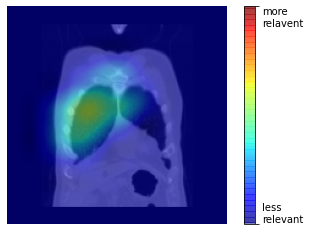

coronal idx 69


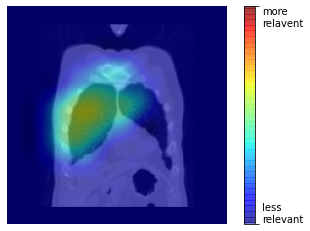

coronal idx 70


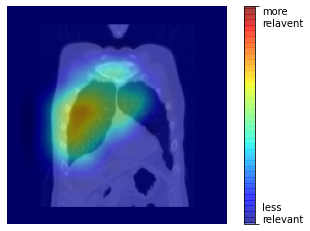

coronal idx 71


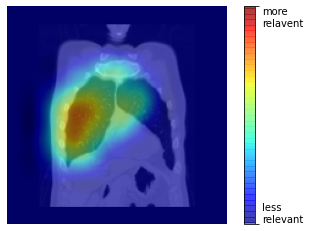

coronal idx 72


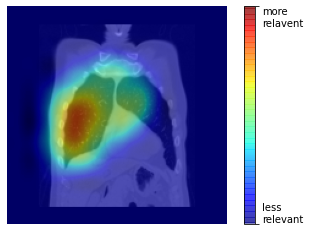

coronal idx 73


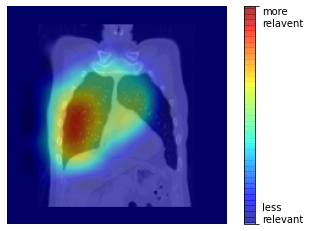

coronal idx 74


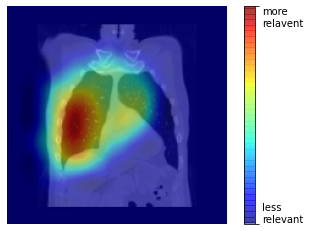

coronal idx 75


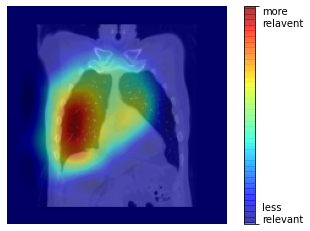

coronal idx 76


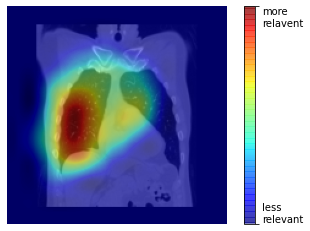

coronal idx 77


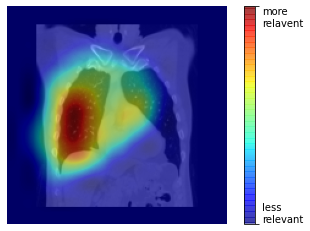

coronal idx 78


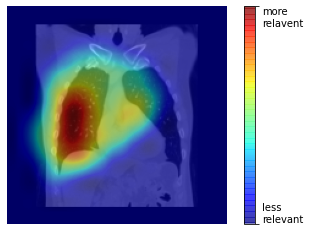

coronal idx 79


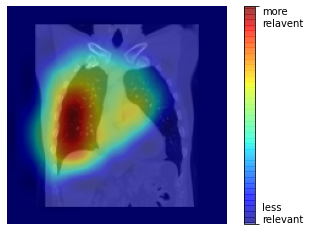

coronal idx 80


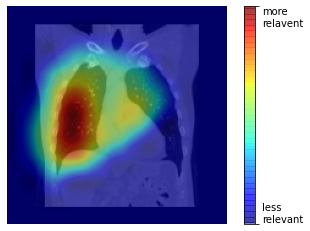

(79, 54, 89)
0.25 0.312255859375


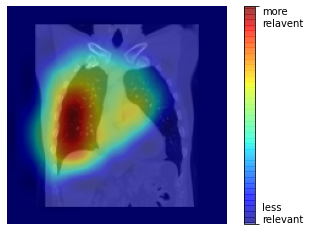

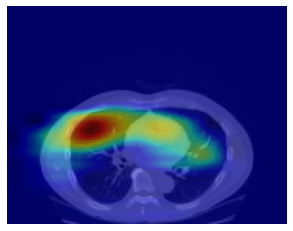



1852251152


,examID,sex,age,Ht,Wt,BMI,허리둘레,FEV1_MEAS,FEV1_%PRED,FVC_MEAS,FVC_%PRED,FEV1/FVC_MEAS
664,1852251152,M,46,182.3,77.8,23.41,90.0,4.18,95,5.22,96,80


M


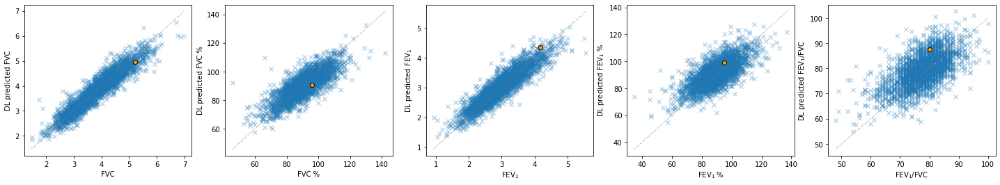

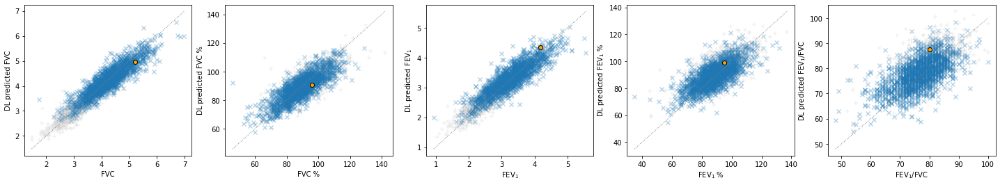

max coronal idx 99
maximum sagittal index:  68
axial max index:  92
coronal idx 87


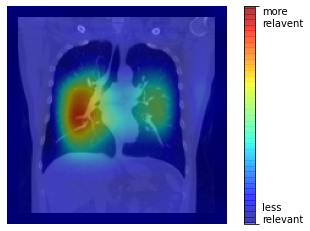

coronal idx 88


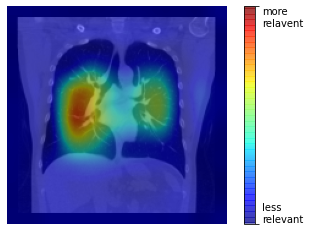

coronal idx 89


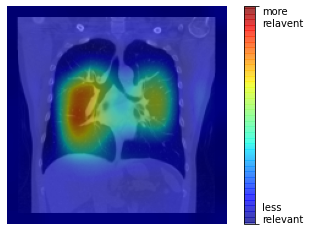

coronal idx 90


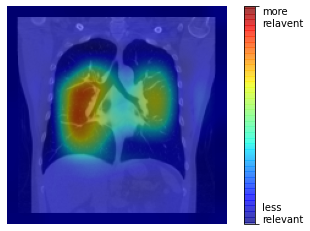

coronal idx 91


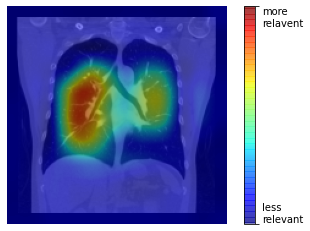

coronal idx 92


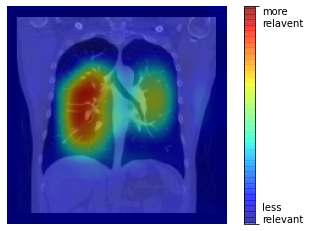

coronal idx 93


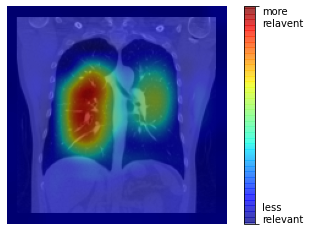

coronal idx 94


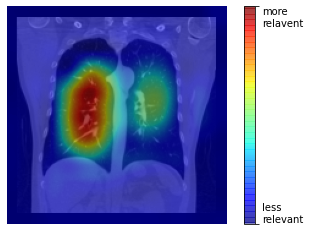

coronal idx 95


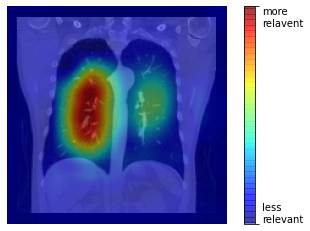

coronal idx 96


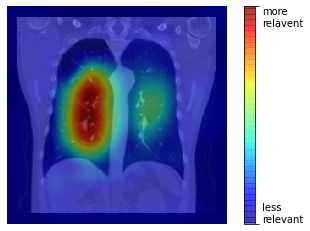

coronal idx 97


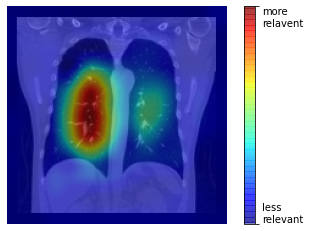

coronal idx 98


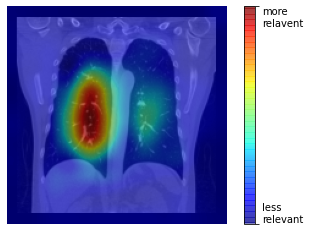

coronal idx 99


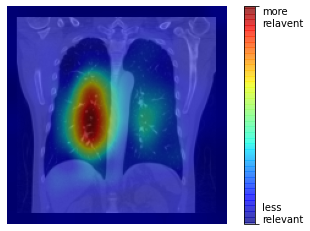

coronal idx 100


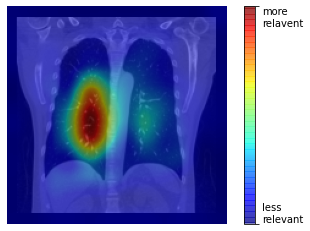

(99, 68, 92)
0.25 0.312255859375


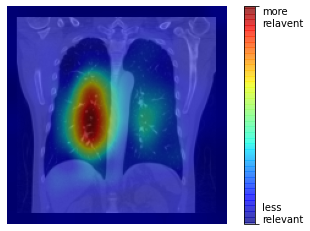

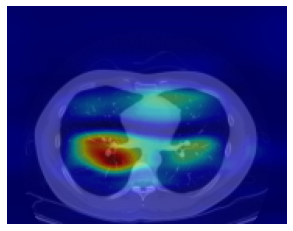

max coronal idx 66
maximum sagittal index:  54
axial max index:  84
coronal idx 54


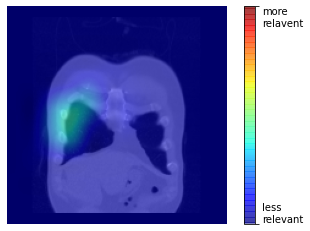

coronal idx 55


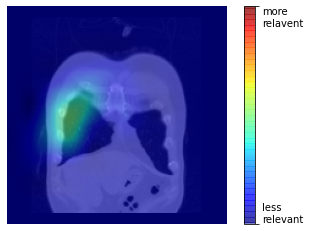

coronal idx 56


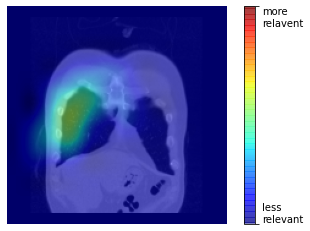

coronal idx 57


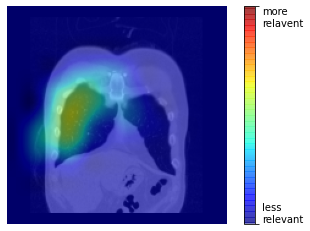

coronal idx 58


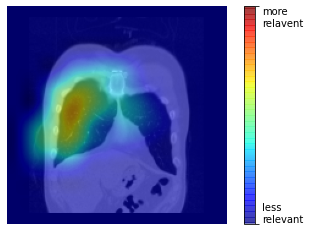

coronal idx 59


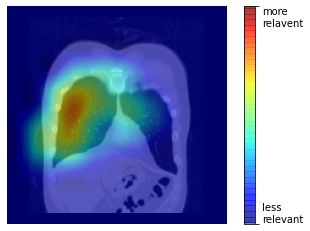

coronal idx 60


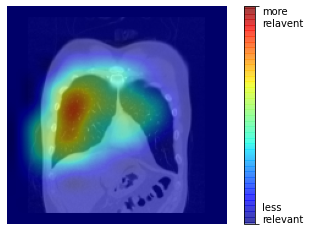

coronal idx 61


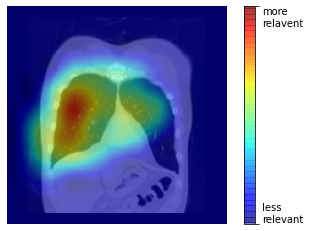

coronal idx 62


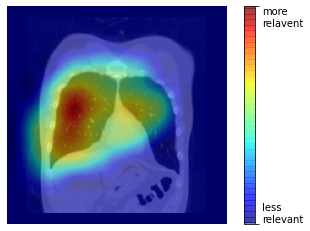

coronal idx 63


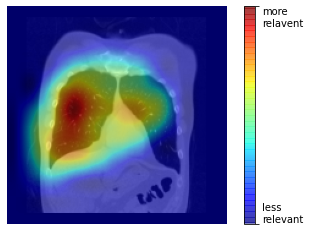

coronal idx 64


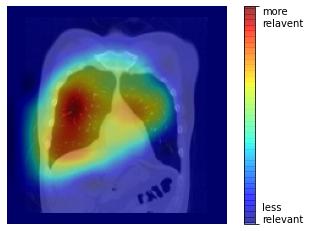

coronal idx 65


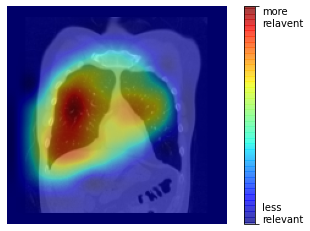

coronal idx 66


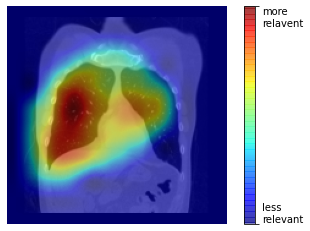

coronal idx 67


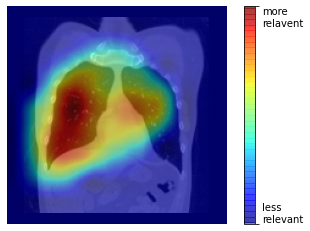

(66, 54, 84)
0.25 0.312255859375


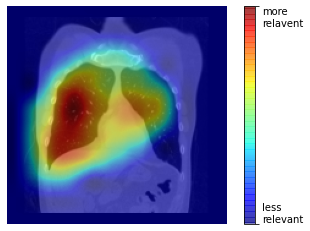

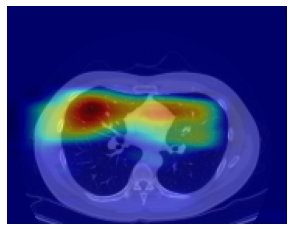

In [92]:
PATH_save = "/workspace/lung_pft/external_validation/05_CAM_with_v3_02_sample_Revision_SuppleS7a"

#---------------
list_ID = df_external["examID"].sample(10, random_state = 10).tolist()
print(df_external[df_external["examID"].isin(list_ID)]["sex"].value_counts())
list_info = ["examID", "sex","age" , 'Ht', 'Wt', 'BMI', '허리둘레', 
             "FEV1_MEAS","FEV1_%PRED",
             "FVC_MEAS","FVC_%PRED",
             "FEV1/FVC_MEAS"
            ]


if not os.path.isdir(PATH_save):
    os.mkdir(PATH_save)
for _ID in list_ID:
    print("\n")
    print("=="*30)
    print(_ID)
    
    df_ID = df_external[df_external["examID"] ==_ID]
    display(df_ID[list_info])
    
    
    _sex = df_ID[ "sex"].values[0]
    _age = df_ID[ "age"].values[0]
    PATH_save_by_ID = os.path.join(PATH_save, f"{_ID}_{_sex}_{_age}")
    if not os.path.isdir(PATH_save_by_ID):
        os.mkdir(PATH_save_by_ID)

    

    print(_sex)
    
    PATH_CT = os.path.join("/workspace/lung_pft/external_validation", "03_crop_padded_v3_skimage_210511",f"{_ID}.hdr")
    img_CT = load_image(PATH_CT)
    img_CT = np.squeeze(img_CT)    

    dict_FEV1_coronal_idx = {"pool": 96,
                            "F": 100, 
                            "M": 95}
    
    dict_idx = {"coronal":[], 
                "sagittal":[],
                "axial":[]}
    
    _list_keys = "FVC_MEAS", "FVC_%PRED", "FEV1_MEAS", "FEV1_%PRED", "FEV1/FVC_MEAS"
    _list_key_filename = "FVC_MEAS", "FVC_PerecentPRED", "FEV1_MEAS", "FEV1_PercentPRED", "FEV1_per_FVC_MEAS"
    _list_labels = "FVC", "FVC %", "FEV$_1$", "FEV$_1$ %", "FEV$_1$/FVC"    
    
    #==============================
    f,a = plt.subplots(ncols = 5, figsize = (25,4))


    for col_idx,(_col, _col_label) in enumerate(zip(_list_keys, _list_labels)):

        a[col_idx].scatter(df_external[_col], df_external[f"modelpredicted({_col})"], marker = "x", alpha = 0.3)
            
        a[col_idx].scatter(df_ID[_col], df_ID[f"modelpredicted({_col})"], marker = "o",ec = "k",color = "orange" )
        a[col_idx].plot([df_external[_col].min(), df_external[_col].max()],[df_external[_col].min(), df_external[_col].max()],
                color = "gray",
                linewidth = "1", 
                linestyle = "dotted")
        a[col_idx].set_xlabel(_col_label)
        a[col_idx].set_ylabel(f"DL predicted {_col_label}")
    plt.savefig(os.path.join(PATH_save_by_ID, f"scatter_{_ID}.png"),
                bbox_inches = "tight",
               dpi = 300)
    plt.show()
    
    #==============================
    f,a = plt.subplots(ncols = 5, figsize = (25,4))
    
    dict_sactter_kwargs = {"belonged_gender":{"marker": "x",
                                             "alpha" : 0.3},
                          "other_gender" :{"marker": "+",
                                          "color": "lightgray",
                                          "alpha": 0.3}}
    if _sex == "F":
        order_sex = ["M", "F"]
    elif _sex =="M":
        order_sex =["F", "M"]
    
    
    for col_idx,(_col, _col_label) in enumerate(zip(_list_keys, _list_labels)):
        for sex_group in order_sex:
            _df_sex = df_external[df_external["sex"] ==sex_group]
            if sex_group ==_sex:
                sex_group_label = "belonged_gender"
            else:
                sex_group_label = "other_gender"
            a[col_idx].scatter(_df_sex[_col], _df_sex[f"modelpredicted({_col})"], **dict_sactter_kwargs[sex_group_label])
            
        a[col_idx].scatter(df_ID[_col], df_ID[f"modelpredicted({_col})"], marker = "o",ec = "k",color = "orange", alpha = 1 )
        a[col_idx].plot([df_external[_col].min(), df_external[_col].max()],[df_external[_col].min(), df_external[_col].max()],
                color = "gray",
                linewidth = "1", 
                linestyle = "dotted")
        a[col_idx].set_xlabel(_col_label)
        a[col_idx].set_ylabel(f"DL predicted {_col_label}")
    plt.savefig(os.path.join(PATH_save_by_ID, f"scatter_{_ID}_gender_annotate.png"),
                bbox_inches = "tight",
               dpi = 300)
    plt.show()
    #==============================
    
    
    
    
    
    
    
    
    
    for _PFT in ["FEV1", "FVC"]:
        PATH_CAM_dir = "/workspace/lung_pft/external_validation/05_CAM_with_v3"
        PATH_CAM = os.path.join(PATH_CAM_dir, _PFT, f"{_ID}.hdr")
        _img_CAM =  sitk.GetArrayFromImage(sitk.ReadImage(PATH_CAM))
        _img_CAM = load_image(PATH_CAM)
        _img_CAM = np.squeeze(_img_CAM) 
        
        savename = f"{_ID}_CAM_{_PFT}"
        max_coronal_idx, max_sagittal_idx, max_axial_idx = get_max_idx(_img_CAM, img_CT, PATH_save_by_ID, savename,
                                                                      draw_sequential = True)
        
#         if _PFT =="FEV1":
#                """subjectiveluy chosen"""
#             max_coronal_idx = dict_FEV1_coronal_idx[_group]
            
        list_max_idx = max_coronal_idx, max_sagittal_idx, max_axial_idx   
        print(list_max_idx)
        savename = f"{_ID}_CAM_CHOSEN_{_PFT}"
        plot_max_CAM(_img_CAM, img_CT,list_max_idx , PATH_save_by_ID, savename,
                     with_line = False, 
                      save = True)    
        
        dict_idx["coronal"].append(max_coronal_idx)
        dict_idx["sagittal"].append(max_sagittal_idx)
        dict_idx["axial"].append(max_axial_idx)


# Figure S8 - Distribution of the samples for averaged intensity of Gradient-weighted class activation mapping
modified  on 2022.05.12

In [6]:
now = datetime.strftime(datetime.now(timezone('Asia/Seoul')), "%Y%m%d%H%M%S")
print(now)

20221004215047


In [7]:
PATH_data = "/workspace/lung_pft/hj_temp/_data/LDCT_FirstVisit_validation_220326"

In [8]:

_filepath = os.path.join(PATH_data,"df_target_test_with_result_col_rename.xlsx")

df_external = pd.read_excel(_filepath,
                       index_col = 0, 
                         engine = "openpyxl")
print(df_external.shape)
print(df_external.keys())

(2720, 90)
Index(['examID', 'ID_path', 'dir_name', 'target_path', 'check_dir_exist',
       '연구번호', 'HE0108(R5253A)검사접수번호', 'HE0109(R5253)검사접수번호', 'EXCEL',
       'PYTHON', 'sex', 'exam_date', 'age', '내원번호', 'Ht', 'Wt', 'BMI', '허리둘레',
       'SBP', 'DBP', 'Q0002 귀하께서는 암을 진단 받은 적이 있습니까?',
       'Q0003 진단 받은 암을 선택해 주시겠습니까? (복수 응답 가능)',
       'Q0214 폐질환, 신장/요로/전립선질환, 간/담도질환, 식도/위/대장질환 및 갑상선 질환이 있습니까?',
       'Q0229 과거력(폐,비뇨기,소화기,갑상선) 을 선택해 주시겠습니까? (복수 응답 가능)',
       'Q0012 복용/주사 중인 약을 선택해 주시겠습니까? (복수 응답 가능)',
       'Q0016 시술 혹은 수술을 선택해주시겠습니까?(복수 응답 가능)', 'Q0047 귀하는 담배를 피운적이 있습니까?',
       'Q0048 처음 흡연을 시작한 연령은 몇 세입니까?', 'Q0049 흡연을 중단한 연령은 몇 세입니까?',
       'Q0050 하루 평균 흡연량은 얼마입니까? (현재 끊으신분도 과거 하루 평균 흡연량 표시바랍니다)',
       'Q0089 숨찬 증상이 있습니까?', 'Q0211 흉부 통증이 있습니까?',
       'Q0090 상기도 및 호흡기계 증상이 있습니까?', 'R5253A 접수일자', 'R5253A 결과본문', 'R5253A 결론',
       'R5253 접수일자', 'R5253 결과본문', 'R5253 결론', 'S2001 접수일자', 'S2001 결론',
       'S2002 접수일자', 'S2002 결론', 'FVC_PRED', 'FVC_MEAS', 'FVC_%PRED',
  

(1, 90)
F number of data: (977, 90)
sex typical lung on 1852267143

46 F 156.6 53.9 21.979
/workspace/lung_pft/external_validation/03_crop_padded_v3_skimage_210511/1852267143.hdr
/workspace/lung_pft/external_validation/04_lung_seg_mask/04_02_Lung_Mask_crop_padded/1852267143.hdr
/workspace/lung_pft/external_validation/05_CAM_with_v3/FEV1/1852381383.hdr
03_crop_padded_v3_skimage_210511_1852267143.hdr
04_02_Lung_Mask_crop_padded_1852267143.hdr
03_crop_padded_v3_skimage_210511_1852267143.img
04_02_Lung_Mask_crop_padded_1852267143.img
(178, 140, 180) (178, 140, 180)
location of the lung (47, 139, 64, 124, 40, 137)
size of the lung [93 61 98]
making /workspace/lung_pft/external_validation/05_CAM_with_v3_01_averaged/on_sex_F_1852267143
03_crop_padded_v3_skimage_210511_1852267143.hdr
04_02_Lung_Mask_crop_padded_1852267143.hdr
03_crop_padded_v3_skimage_210511_1852267143.img
04_02_Lung_Mask_crop_padded_1852267143.img

M number of data: (1743, 90)
sex typical lung on 1852003912

52 M 176.2 69.7 22.45
/workspace/lung_pft/external_validation/03_crop_padded_v3_skimage_210511/1852003912.hdr
/workspace/lung_pft/external_validation/04_lung_seg_mask/04_02_Lung_Mask_crop_padded/1852003912.hdr
/workspace/lung_pft/external_validation/05_CAM_with_v3/FEV1/1852109728.hdr
03_crop_padded_v3_skimage_210511_1852003912.hdr
04_02_Lung_Mask_crop_padded_1852003912.hdr
03_crop_padded_v3_skimage_210511_1852003912.img
04_02_Lung_Mask_crop_padded_1852003912.img
(178, 140, 180) (178, 140, 180)
location of the lung (35, 149, 51, 124, 30, 146)
size of the lung [115 74 117]
making /workspace/lung_pft/external_validation/05_CAM_with_v3_01_averaged/on_sex_M_1852003912
03_crop_padded_v3_skimage_210511_1852003912.hdr
04_02_Lung_Mask_crop_padded_1852003912.hdr
03_crop_padded_v3_skimage_210511_1852003912.img
04_02_Lung_Mask_crop_padded_1852003912.img
FVC_1852003912.hdr
FVC_1852003912.img

examID [1852210331]
age [54]
sex ['M']
Ht [171.6]
Wt [70.1]
BMI [23.806]
FVC_MEAS [4.4]
FVC_%PRED [92]
FEV1_MEAS [3.29]
FEV1_%PRED [88]
volume_lungmask [301545]
volume_bbox [848232]

In [28]:
df_external.keys()

Index(['examID', 'ID_path', 'dir_name', 'target_path', 'check_dir_exist',
       '연구번호', 'HE0108(R5253A)검사접수번호', 'HE0109(R5253)검사접수번호', 'EXCEL',
       'PYTHON', 'sex', 'exam_date', 'age', '내원번호', 'Ht', 'Wt', 'BMI', '허리둘레',
       'SBP', 'DBP', 'Q0002 귀하께서는 암을 진단 받은 적이 있습니까?',
       'Q0003 진단 받은 암을 선택해 주시겠습니까? (복수 응답 가능)',
       'Q0214 폐질환, 신장/요로/전립선질환, 간/담도질환, 식도/위/대장질환 및 갑상선 질환이 있습니까?',
       'Q0229 과거력(폐,비뇨기,소화기,갑상선) 을 선택해 주시겠습니까? (복수 응답 가능)',
       'Q0012 복용/주사 중인 약을 선택해 주시겠습니까? (복수 응답 가능)',
       'Q0016 시술 혹은 수술을 선택해주시겠습니까?(복수 응답 가능)', 'Q0047 귀하는 담배를 피운적이 있습니까?',
       'Q0048 처음 흡연을 시작한 연령은 몇 세입니까?', 'Q0049 흡연을 중단한 연령은 몇 세입니까?',
       'Q0050 하루 평균 흡연량은 얼마입니까? (현재 끊으신분도 과거 하루 평균 흡연량 표시바랍니다)',
       'Q0089 숨찬 증상이 있습니까?', 'Q0211 흉부 통증이 있습니까?',
       'Q0090 상기도 및 호흡기계 증상이 있습니까?', 'R5253A 접수일자', 'R5253A 결과본문', 'R5253A 결론',
       'R5253 접수일자', 'R5253 결과본문', 'R5253 결론', 'S2001 접수일자', 'S2001 결론',
       'S2002 접수일자', 'S2002 결론', 'FVC_PRED', 'FVC_MEAS', 'FVC_%PRED',
       'FEV1_

In [11]:

ID_pooling = 1852210331

list_ID = [ID_F, ID_M, ID_pooling]
list_group = ["F", "M", "pool"]

In [12]:

list_keys = "FVC_MEAS", "FVC_%PRED", "FEV1_MEAS", "FEV1_%PRED", "FEV1/FVC_MEAS"
list_key_filename = "FVC_MEAS", "FVC_PerecentPRED", "FEV1_MEAS", "FEV1_PercentPRED", "FEV1_per_FVC_MEAS"
list_xlabel = "FVC", "FVC %", "FEV$_1$", "FEV$_1$ %", "FEV$_1$/FVC"
list_ylabel = "FVC$\it{_D}\it{_L}$", "FVC %$\it{_D}\it{_L}$", "FEV$_1$ $\it{_D}\it{_L}$", "FEV$_1$ %$\it{_D}\it{_L}$", "FEV$_1$/FVC$\it{_D}\it{_L}$"

scatter_marker  = {"marker":".",
                  "alpha": 0.2}
line_styles = {"linewidth": 0.5,
              "linestyle":(0, (3,2)),
               "color" :"k"
              }

In [19]:
color_refer = np.array([211,95,183])/255

In [20]:
color_refer

array([0.82745098, 0.37254902, 0.71764706])

202220927
1852210331 pool
M    1743
F     977
Name: sex, dtype: int64
M    128
F     72
Name: sex, dtype: int64
FVC_MEAS modelpredicted(FVC_MEAS)


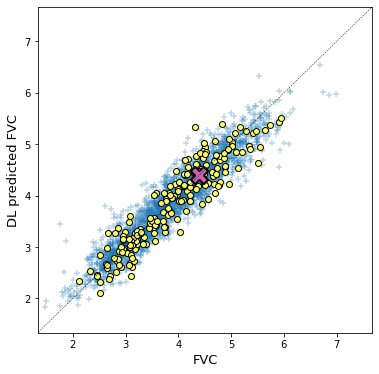

FVC_%PRED modelpredicted(FVC_%PRED)


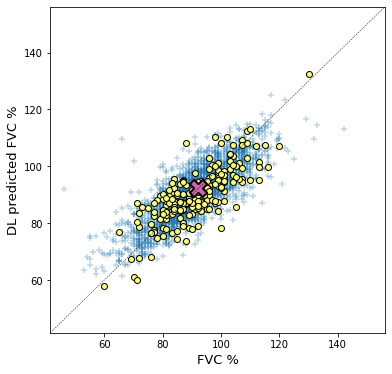

FEV1_MEAS modelpredicted(FEV1_MEAS)


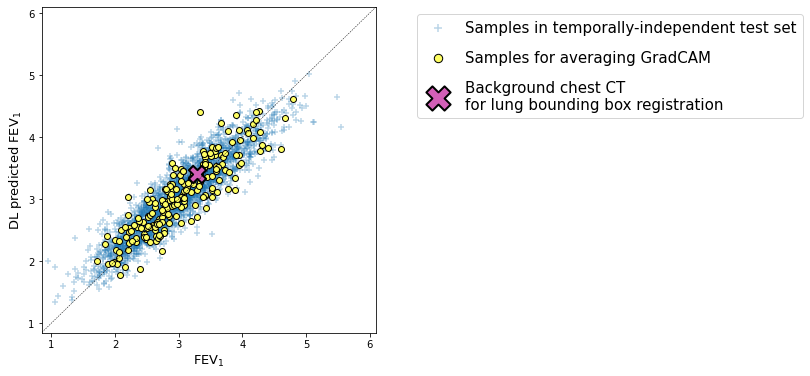

FEV1_%PRED modelpredicted(FEV1_%PRED)


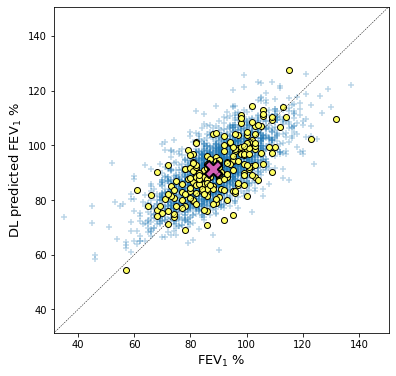

FEV1/FVC_MEAS modelpredicted(FEV1/FVC_MEAS)


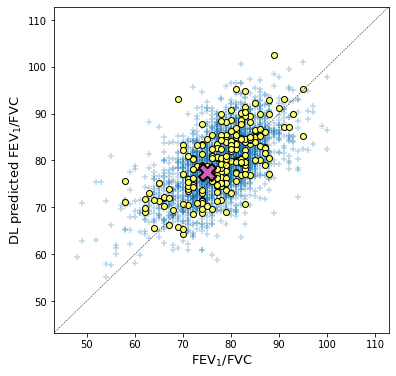

In [26]:
trial_num = 202220927
print(trial_num)

ID_pooling = 1852210331

list_ID = [ ID_pooling]
list_group = ["pool"]

##=======================
PATH_save = os.path.join("/workspace/lung_pft/hj_temp/PFT_publish1_Supplementary_AverageCAMSelection")
if not os.path.isdir(PATH_save):
    os.mkdir(PATH_save)

##=======================
trial_time = datetime.strftime(datetime.now(timezone('Asia/Seoul')), "%Y%m%d%H%M%S")
PATH_trial = os.path.join(PATH_save, f"trial{trial_num}_{trial_time}")
os.mkdir(PATH_trial)

##=======================

for _ID,_group in zip(list_ID, list_group):
    print(_ID, _group)
    os.mkdir(os.path.join(PATH_trial, _group))
    
    if _group =="pool":
        df_target = df_external.copy()
    else:
        df_target = df_external[df_external["sex"] ==_group]
        
    df_sample = df_target.sample(n = 200, random_state = 1).reset_index(drop = True)
    df_refer = df_external[df_external["examID"] ==_ID]
    print(df_target["sex"].value_counts())
    print(df_sample["sex"].value_counts())
    
    color_refer = np.array([211,95,183])/255
    color_sample = np.array([254,254,98])/255
    dict_marker = {"refer":{"marker": "X",
                            "linewidth":2,
                             "alpha": 1,
                            "s": 300,
                             "color": color_refer, 
                             "ec"   : "k"},
                  "target":{"marker": "+",
                             "alpha": 0.3},
                  "sample":{"marker": "o",
                             "alpha": 1,
                             "color": color_sample,
                             "ec"   : "k"}}
    
    for _i, _key in enumerate(list_keys):

        _xcol = _key
        _ycol = f"modelpredicted({_key})"
        print(_xcol, _ycol)
        _min = (np.min(df_external[[_xcol, _ycol]])).min() * 0.9
        _max = (np.max(df_external[[_xcol, _ycol]])).max() * 1.1
        
        plt.figure(figsize = (6,6))
        list_handles = []
        for _set, _df in zip(['target', 'sample', 'refer'], \
                             [df_target, df_sample, df_refer]):
            _x = _df[_xcol]
            _y = _df[_ycol]
            list_handles.append(plt.scatter(_x, _y, **dict_marker[_set]))
            
            
        plt.plot([0, 160], [0, 160], **line_styles)
        plt.xlim(_min, _max)
        plt.ylim(_min, _max)
        
        # trial 9
#         plt.xlabel(list_xlabel[_i], fontsize = 13)
#         plt.ylabel(list_ylabel[_i], fontsize = 13)

#         # trial 10
        plt.xlabel(list_xlabel[_i], fontsize = 13)
        plt.ylabel(f"DL predicted {list_xlabel[_i]}", fontsize = 13)
#         plt.title(list_xlabel[_i], fontsize = 15)


        if _key =="FEV1_MEAS":
            plt.legend(list_handles, 
                       ["Samples in temporally-independent test set", 
                        "Samples for averaging GradCAM", 
                        "Background chest CT\nfor lung bounding box registration"],
                      bbox_to_anchor = (1.1,1),
                       markerscale = 1.4,
                      fontsize = 15,
                       labelspacing = 1
                       
                      )
        
        dpi = 600
        filename = f"Supple_FigureX_{_group}_{_i}_{list_key_filename[_i]}_dpi{dpi}.png"
        plt.savefig(os.path.join(PATH_trial, _group, filename), 
                    dpi = dpi, 
                   bbox_inches = "tight")
        plt.show()
            
        
            
            
        
        
        
        


trial_num += 1

